In [1]:
from IPython.display import HTML, Markdown
import time

handle = display(HTML("""<marquee>👌</marquee>"""), display_id='html_marquee1')
time.sleep(2)
handle = display(HTML("""<marquee>~ "The world is one BigData problem." – Andrew McAfee</marquee>"""), display_id='html_marquee1', update=True)

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Executive Summary</div>

<div class="alert alert-block alert-info"> 📌 <b>Summary</b>: This notebook is intended to 
<ul>
    <li>Provide the exhaustive EDA on BigData-scale training and testing accelerometer feeds data, the part of the dataset for <a href="https://www.kaggle.com/competitions/child-mind-institute-detect-sleep-states" target='_blannk'>Child Mind Institute - Detect Sleep States contest</a></li>
    <li>Summarize the insights</li>
    <li>Provide a well-formed wall-through the BigData-scale dataset analytics/visualization where bigger-then-memory size of the data make it impossible or nearly impossible to use the conventional EDA approaches and techniques</li>
</ul></div>

In order to perform the analytics operations to get the insights on training and testing series data (BigData-scale data, indeed), we leveraged DuckDB, the fast, lightweight, and easy-to-use analytics database with a good API/wrappers for Python.

The key takeaways for the BigData-scale EDA drills on training and testing series are listed below

- there is a lack of the systematic patterns in the population-level and series-level distribution and aggregated statistics for *enmo* and *angllez* in both training and test seria sets
- distribution and summary statistics of *enmo* and *angllez* are significantly different in training seria vs. test seria
- test series data contain the *enmo* and *angllez* feeds for just three seria, 1 h long each; such a structure of the test set may impose some complications/road blocks to the ML solutions attempting to tackle the contest problem in the regression setup
- the average values of *enmo* are typically lower for the hours where *onset* events are more frequent (in the training set)
- the average values of *enmo* are typically lower for the hours where *wakeup* events are more frequent (in the training set)
- the average values of *anglez* are typically higher for the hours where *wakeup* events are more frequent (although we can see some hours without major number of *wakeup* events to have the similar average values of *anglez*)
- the average values of *anglez* are typically lower for the hours where *onset* events are more frequent

Regarding the intervals of sleeping and being awake, we also noticed the facts below
- the average values of *anglez* are even more high in the time intervals where a person is awake (it can be even higher then the average values for the hours with the bigger number of *wakeup* events registered)
- higher values of *enmo* are observed for the awake state of the observable humans

<div class="alert alert-block alert-success"> 💥 <b>Highlights</b>: The above-mentioned finding about the hourly patterns in matching <i>onset/wakeup</i> events to the average hourly values of <i>enmo</i> and <i>angllez</i>, combined with the earlier detected findings on the lack of the systematic patterns in the population-level and series-level distribution and aggregated statistics for <i>enmo</i> and <i>angllez</i>, may highlight an interesting forecasting strategy. <br><br>
    
The ML solution can focus on scanning the time series breakpoints where simultaneoursly observed are
<ul>
    <li>drastic decrease in <i>enmo</i> and <i>anglez</i> values (to indicate a point suspicious of <b><i>onset</i></b> event) </li>
    <li>drastic decrease in <i>enmo</i> value and increase in <i>anglez</i> value (to indicate a point suspicious of <b><i>wakeup</i></b> event) </li>
</ul>
</div>

<div class="alert alert-block alert-info"> ✅ <b>Note</b>: The data insights about the training and testing series collected across this notebook extend the body of EDA findings per the <a href="https://www.kaggle.com/code/gvyshnya/to-sleep-or-not-to-sleep-deep-eda-dive/" target="_blank">master EDA notebook</a>.</div>

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Prerequisites</div>

Before doing the BigData-scale analytics itself, we are going to complete the preparational steps below
- import additional Python packages needed in our work (namely, *duckdb*)
- start the instance of the in-memory database engine managed by DuckDB
- mount the dataset files (*train_series.parquet*, *test_series.parquet*, and *train_events.csv*) as tables in the in-memory DuckDB database
- create and publish the custom Python function to automate certain routines as for the data retrieval from DuckDB as well as building the visualizations

In [2]:
# !pip install jupysql duckdb duckdb-engine pyarrow --quiet

In [3]:
!pip install duckdb --quiet

In [4]:
# Importing gc module
import gc

import pandas as pd
import numpy as np
import datetime as dt


from scipy.signal import spectrogram

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.dates as mdates
import seaborn as sns

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.offline

In [5]:
import duckdb

parquet_table = '/kaggle/input/child-mind-institute-detect-sleep-states/train_series.parquet'
testing_parquet_table = '/kaggle/input/child-mind-institute-detect-sleep-states/test_series.parquet'
training_events_table = '/kaggle/input/child-mind-institute-detect-sleep-states/train_events.csv'

con = duckdb.connect()

In [6]:
con.execute(f"""
    CREATE TABLE train_series AS
    SELECT * 
    FROM read_parquet('{parquet_table}');
""")

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [7]:
con.execute(f"""
    CREATE TABLE test_series AS
    SELECT * 
    FROM read_parquet('{testing_parquet_table}');
""")

In [8]:
# we intentionally load every col as VARCHAR; we need to load timestamp as a varchar, to prevent the UTC time casting at load
con.execute(f"""
    CREATE TABLE train_events AS
    SELECT * 
    FROM read_csv('{training_events_table}', ALL_VARCHAR=1, AUTO_DETECT=TRUE);
""")

In [9]:
def get_all_series_boxplot_data(table, col_name, where_clause = None):
    min_max_sql = ""
    quantile_sql = ""
    if where_clause:
        min_max_sql = f"""
            SELECT series_id, 
            MIN({col_name}) AS min_value, 
            AVG({col_name}) AS mean_value, 
            MAX({col_name}) AS max_value,
            stddev_pop({col_name}) AS stddev
            FROM {table}
            GROUP BY series_id
            WHERE {where_clause}
        """
        quantile_sql = f"""
            WITH stats as (
              SELECT
                series_id,
                percentile_disc([0.25, 0.50, 0.75]) WITHIN GROUP 
                  (ORDER BY {col_name}) AS percentiles
              FROM {table}
              GROUP BY series_id
              WHERE {where_clause}
            )
            SELECT
              series_id,
              percentiles[1] as q1,
              percentiles[2] as median,
              percentiles[3] as q3
            FROM stats;
        """
    else:
        min_max_sql = f"""
            SELECT series_id, 
            MIN({col_name}) AS min_value, 
            AVG({col_name}) AS mean_value, 
            MAX({col_name}) AS max_value,
            stddev_pop({col_name}) AS stddev
            FROM {table}
            GROUP BY series_id
        """
        quantile_sql = f"""
            WITH stats as (
              SELECT
                series_id,
                percentile_disc([0.25, 0.50, 0.75]) WITHIN GROUP 
                  (ORDER BY {col_name}) AS percentiles
              FROM {table}
              GROUP BY series_id
            )
            SELECT
              series_id,
              percentiles[1] as q1,
              percentiles[2] as median,
              percentiles[3] as q3
            FROM stats;
        """
    df_mean_max = con.execute(min_max_sql).fetchdf()
    df_quantile = con.execute(quantile_sql).fetchdf()
    
    df = pd.merge(
        df_mean_max,
        df_quantile,
        how="inner",
        on='series_id')
    
    #rearrange the order of cols to make it a canonical boxplot style
    df = df[['series_id', 'min_value', 'q1', 'median', 'q3', 'max_value', 'mean_value', 'stddev']]
    
    return df

In [10]:
def get_boxplot_data(table, col_name, where_clause = None):
    min_max_sql = ""
    quantile_sql = ""
    if where_clause:
        min_max_sql = f"""
            SELECT '{col_name}' AS attribute, 
            MIN({col_name}) AS min_value, 
            AVG({col_name}) AS mean_value, 
            MAX({col_name}) AS max_value,
            stddev_pop({col_name}) AS stddev
            FROM {table}
            WHERE {where_clause}
        """
        quantile_sql = f"""
            WITH stats as (
              SELECT
                percentile_disc([0.25, 0.50, 0.75]) WITHIN GROUP 
                  (ORDER BY {col_name}) AS percentiles
              FROM {table}
              WHERE {where_clause}
            )
            SELECT
              '{col_name}' AS attribute,
              percentiles[1] as q1,
              percentiles[2] as median,
              percentiles[3] as q3
            FROM stats;
        """
    else:
        min_max_sql = f"""
            SELECT '{col_name}' AS attribute, 
            MIN({col_name}) AS min_value, 
            AVG({col_name}) AS mean_value, 
            MAX({col_name}) AS max_value,
            stddev_pop({col_name}) AS stddev
            FROM {table}
        """
        quantile_sql = f"""
            WITH stats as (
              SELECT
                percentile_disc([0.25, 0.50, 0.75]) WITHIN GROUP 
                  (ORDER BY {col_name}) AS percentiles
              FROM {table}
            )
            SELECT
              '{col_name}' AS attribute,
              percentiles[1] as q1,
              percentiles[2] as median,
              percentiles[3] as q3
            FROM stats;
        """
    df_mean_max = con.execute(min_max_sql).fetchdf()
    df_quantile = con.execute(quantile_sql).fetchdf()
    
    df = pd.merge(
        df_mean_max,
        df_quantile,
        how="inner",
        on='attribute')
    
    #rearrange the order of cols to make it a canonical boxplot style
    df = df[['attribute', 'min_value', 'q1', 'median', 'q3', 'max_value', 'mean_value', 'stddev']]
    
    return df

def build_boxplot(table, col_name, where_clause = None):
    df = get_boxplot_data(table, col_name, where_clause)
    fig_title = ""
    
    bar_name = "".join([table, ".", col_name])
    
    if where_clause:
        fig_title = "".join([table, ".", col_name, ": ", where_clause])
    else:
        fig_title = "".join([table, ".", col_name, ": Entire table population"])
    
    fig = go.Figure()

    fig.add_trace(go.Box(
        y= [ df['min_value'].iloc[0], df['max_value'].iloc[0] ],
        name=bar_name, boxpoints=False,)
      )

    fig.update_traces(q1=[ df['q1'].iloc[0] ], median=[ df['median'].iloc[0] ],
                  q3=[ df['q3'].iloc[0] ], lowerfence=[df['min_value'].iloc[0]],
                  upperfence=[df['max_value'].iloc[0]], mean=[ df['mean_value'].iloc[0] ],
                  sd=[ df['stddev'].iloc[0]]
                 )
    # Update visual layout
    fig.update_layout(
        showlegend=False,
        width=600,
        height=400,
        autosize=False,
        margin=dict(t=15, b=0, l=5, r=5),
        title=dict(text=fig_title, font=dict(size=16), automargin=True, yref='paper'),
        title_x=0.5, # center the title
        template="plotly_white",
        colorway=px.colors.qualitative.Prism ,
    )
    
    # update font size at the axes
    fig.update_coloraxes(colorbar_tickfont_size=10)
    # Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
    fig.update_annotations(font_size=12)
    # Reduce opacity
    fig.update_traces(opacity=0.75)
    
    return fig

In [11]:
# https://duckdb.org/docs/sql/aggregates
def get_histogram_data(table, col_name, where_clause = None):
    query = ""
    if where_clause:
        query = f"""
            SELECT histogram({col_name}) FROM {table}
            WHERE {where_clause};
        """
    else:
        query = f"""
            SELECT histogram({col_name}) FROM {table};
        """
    df = con.execute(query).fetchdf()
    
    hist_col_name = f"histogram({col_name})"

    histogram_dict = df[hist_col_name].iloc[0] # dictionary: dict_keys(['key', 'value'])

    frame = {
        col_name: histogram_dict.get('key'),
        'record_count': histogram_dict.get('value')}
 
    # Creating DataFrame by passing Dictionary
    agg_data = pd.DataFrame(frame)
    return agg_data
    
def build_histogram(table, col_name, where_clause = None):
    figure_title = ""
    if where_clause:
        figure_title = f"Distribution of {col_name} in {table}; filter: {where_clause}"
    else:
        figure_title = f"Distribution of {col_name} in {table}"
    
    agg_data = get_histogram_data(table, col_name, where_clause)
    
    fig = px.histogram(agg_data, x=col_name, marginal="rug",
                   title=figure_title,
                   color_discrete_sequence=px.colors.qualitative.Prism)
    return fig

In [12]:
def get_histogram_data_2(table, col_name, where_clause = None):
    query = ""
    if where_clause:
        query = f"""
        SELECT FLOOR({col_name}/1.00)*1 AS {col_name}, 
           COUNT(*) AS record_count
        FROM {table}
        WHERE {where_clause}
        GROUP BY FLOOR({col_name}/1.00)*1
        ORDER BY 1
        """
    else:
        query = f"""
        SELECT FLOOR({col_name}/1.00)*1 AS {col_name}, 
           COUNT(*) AS record_count
        FROM {table}
        GROUP BY FLOOR({col_name}/1.00)*1
        ORDER BY 1
    """
    df_agg = con.execute(query).fetchdf()
    return df_agg

def build_histogram_2(table, col_name, where_clause = None):
    fig_title = ""
    if where_clause:
        fig_title = f"Distribution of {col_name}: {table}; filtered: {where_clause}"
    else:
        fig_title = f"Distribution of {col_name}: {table}"
    df_agg = get_histogram_data_2(table, col_name, where_clause)
    fig = px.bar(df_agg, x=col_name, y="record_count",
                   title="Distribution of anglez: training series",
                   color_discrete_sequence=px.colors.qualitative.Prism)
    return fig

In [13]:
def get_hourly_averages(table, col_name, where_clause = None):
    query = ""
    if where_clause:
        query = f"""
            WITH hours_of_day AS (
                SELECT extract('hour' FROM 
                    strptime(substring(replace(timestamp, 'T', ' '), 1, length(timestamp)-5), '%Y-%m-%d %H:%M:%S')) AS hour_of_day,
                    {col_name}
                FROM {table}
                WHERE {where_clause}
            )
            SELECT
                hour_of_day, 
                AVG({col_name}) AS avg_{col_name}
            FROM hours_of_day
            GROUP BY 1
            ORDER BY 1
        """
    else:
        query = f"""
            WITH hours_of_day AS (
                SELECT extract('hour' FROM 
                    strptime(substring(replace(timestamp, 'T', ' '), 1, length(timestamp)-5), '%Y-%m-%d %H:%M:%S')) AS hour_of_day,
                    {col_name}
                FROM {table}
            )
            SELECT
                hour_of_day, 
                AVG({col_name}) AS avg_{col_name}
            FROM hours_of_day
            GROUP BY 1
            ORDER BY 1
        """
    df_agg = con.execute(query).fetchdf()
    return df_agg


def build_hourly_averages_bar(table, col_name, where_clause = None):
    y_variable = f"avg_{col_name}"
    fig_title = ""
    if where_clause:
        fig_title = f"Average {col_name} by hours in a day (local time); filtered: {where_clause}"
    else:
        fig_title = f"Average {col_name} by hours in a day (local time)"
    df_agg = get_hourly_averages(table, col_name, where_clause)
    fig = px.bar(df_agg, x='hour_of_day', y=y_variable,
                   title=fig_title,
                   color_discrete_sequence=px.colors.qualitative.Prism)
    return fig

In [14]:
def get_events_hourly_counts(where_clause = None):
    query = ""
    if where_clause:
        query = f"""
            WITH hours_of_day AS (
                SELECT extract('hour' FROM 
                    strptime(substring(replace(timestamp, 'T', ' '), 1, length(timestamp)-5), '%Y-%m-%d %H:%M:%S')) AS hour_of_day,
                    event
                FROM train_events
                WHERE {where_clause}
            )
            SELECT
                event,
                hour_of_day,  
                COUNT(*) AS event_count
            FROM hours_of_day
            GROUP BY 1,2
            ORDER BY 1,2
        """
    else:
        query = f"""
            WITH hours_of_day AS (
                SELECT extract('hour' FROM 
                    strptime(substring(replace(timestamp, 'T', ' '), 1, length(timestamp)-5), '%Y-%m-%d %H:%M:%S')) AS hour_of_day,
                    event
                FROM train_events
            )
            SELECT
                event,
                hour_of_day, 
                COUNT(*) AS event_count
            FROM hours_of_day
            GROUP BY 1,2
            ORDER BY 1,2
        """
    df_agg = con.execute(query).fetchdf()
    return df_agg

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Training vs. Testing Series in Comparison</div>

Let's collect and compare the summmary statistics about the training and testing series in terms of
- distribution of enmo and anglez
- summary statistis on enmo and anglez usually visualized in box plots (min, max, median, mean, std, Q1, Q3)
- average values of enmo by hours in a day
- everage values of anglez by hours in a day

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of enmo</div>

Let's calculate and visualize the histograms of *enmo* for both the training and testing series.

In [15]:
fig = build_histogram(table='train_series', col_name='enmo')
fig.show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [16]:
fig = build_histogram(table='test_series', col_name='enmo')
fig.show()

We find that
- the distribution of *enmo* on training and testing series is quite different (although both distributions are severely skewed to the left)
- the most of the *enmo* values in the training series belong to the interval of *0.025..2.175* (within this interval, evey bucket with 0.05 incremental step contains either 500 or 501 observations)
- the most of the *enmo* values in the testing series belong to the interval of *-0.025..0.0749*

In [17]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1514 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics on enmo</div>

Let's extract the summary statistis on enmo and then visualize it for both the training  and testing serias.

Let's start with the training series.

In [18]:
fig = build_boxplot('train_series', 'enmo', where_clause = None)
fig.show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

Now, let's do the same for the testing series

In [19]:
fig = build_boxplot('test_series', 'enmo', where_clause = None)
fig.show()

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Hourly averages: enmo</div>

Let's visualize the hourly average values on *enmo* for the training series data.

In [20]:
fig = build_hourly_averages_bar('train_series', 'enmo')
fig.show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

Now, let's visualize the hourly average values on *enmo* for the test series data.

In [21]:
fig = build_hourly_averages_bar('test_series', 'enmo')
fig.show()

In [22]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2564 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of anglez</div>

Let's visualize distribution of *anglez* in both training and testing sets as histograms.

In [23]:
fig = build_histogram_2('train_series', 'anglez')
fig.show()

In [24]:
fig = build_histogram(table='test_series', col_name='anglez')
fig.show()

In [25]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2229 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics on anglez</div>

In [26]:
df = get_boxplot_data('train_series', 'anglez', where_clause = None)
df

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

,attribute,min_value,q1,median,q3,max_value,mean_value,stddev
0,anglez,-90.0,-31.8589,-9.5979,11.3002,90.0,-8.810476,35.521875


In [27]:
fig = build_boxplot('train_series', 'anglez', where_clause = None)
fig.show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [28]:
df = get_boxplot_data('test_series', 'anglez', where_clause = None)
df

,attribute,min_value,q1,median,q3,max_value,mean_value,stddev
0,anglez,-88.367996,-88.216599,-79.990601,-29.089899,68.460503,-56.17772,39.288209


In [29]:
fig = build_boxplot('test_series', 'anglez', where_clause = None)
fig.show()

In [30]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2146 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Hourly averages: anglez</div>

In [31]:
fig = build_hourly_averages_bar('train_series', 'anglez')
fig.show()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [32]:
fig = build_hourly_averages_bar('test_series', 'anglez')
fig.show()

In [33]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1787 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Training Events</div>

Let's visualize the frequency of the *onset* and *wakeup* events in the training set.

In [34]:
df_agg = get_events_hourly_counts().dropna()

df_onset = df_agg[df_agg['event'] == 'onset']
df_wakeup = df_agg[df_agg['event'] == 'wakeup']

fig = make_subplots(rows=1, cols=2, subplot_titles=('<b>Hourly Frequency of Onset Events</b>',
                                                    '<b>Hourly Frequency of Wakeup Events</b>',
                                                   ))

fig.add_trace(go.Bar(x=df_onset['hour_of_day'], y=df_onset['event_count']), row=1, col=1)
fig.add_trace(go.Bar(x=df_wakeup['hour_of_day'], y=df_wakeup['event_count']), row=1, col=2)
                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=600,
    height=400,
    autosize=False,
    margin=dict(t=15, b=0, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show() 

From the chart displayed, it is evident that the majority of individuals whose sleeping series are represented in the training dataset tend to

- wake up between 6-8 am;
- go to sleep around 8-11 pm.

Such a temporal pattern matches well with general intuition as well as provides a useful baseline for further analyses.

In [35]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 780 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Training Series: Entire Population vs. Individual Series</div>

Let's look at the selective individual training seria to appraise who similar or equally differnt they are (both from each other and from the entire population of the training seria) in terms of
- distribution of *enmo* and *anglez*
- summary statistics charts for *enmo* and *anglez*
- hourly averages for *enmo*, *anglez*, and training events

We are going to specifically scrutinize the subset of *37* training series with fully labelled *onset* and *wakeup* events.

<div class="alert alert-block alert-info"> ✅ <b>Note</b>: You can refer to the <a href="https://www.kaggle.com/code/gvyshnya/to-sleep-or-not-to-sleep-deep-eda-dive/" target="_blank">master EDA notebook</a> to see more info on how such <i>37</i> training series have been located.</div>

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of enmo: selective training series</div>

Let's look at the *enmo* distribution in the selective training seria.

In [36]:
list_of_fully_labelled_seria = ['08db4255286f', '0a96f4993bd7', '0cfc06c129cc', '1087d7b0ff2e', '10f8bc1f7b07', '18b61dd5aae8', 
                                '29c75c018220', '31011ade7c0a', '3452b878e596', '349c5562ee2c', '3664fe9233f9', '483d6545417f', 
                                '55a47ff9dc8a', '5acc9d63b5fd', '5f94bb3e1bed', '655f19eabf1e', '67f5fc60e494', '72bbd1ac3edf', 
                                '76237b9406d5', '7822ee8fe3ec', '89bd631d1769', '8e32047cbc1f', '939932f1822d', '9ee455e4770d', 
                                'a596ad0b82aa', 'a9a2f7fac455', 'a9e5f5314bcb', 'af91d9a50547', 'b364205aba43', 'c535634d7dcd', 
                                'c6788e579967', 'c68260cc9e8f', 'ca730dbf521d', 'd150801f3145', 'd25e479ecbb7', 'd515236bdeec', 
                                'd5e47b94477e']

In [37]:
col_name_to_review = "enmo"
subplot_titles = [ f"<b>Distr. of {col_name_to_review}: series {series_id}</b>" for series_id in list_of_fully_labelled_seria ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=13, cols=3, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in list_of_fully_labelled_seria:
    df = get_histogram_data(table="train_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Histogram(x=df[col_name_to_review], y=df['record_count']), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=900,
    height=1000,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [38]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1676 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics for enmo: selective training series</div>
Let's look at the summary statistics for *enmo* in the selective training seria. We are going to visualize it in a set of boxplot diagrams.

In [39]:
n=37
df_series = get_all_series_boxplot_data('train_series', 'enmo')
df_series_slice = df_series[df_series['series_id'].isin(list_of_fully_labelled_seria[0:n])]

dummy_values = [ 0, 1, 2, 3, 4, 5, 6, 7, 8, 9 ]
dummmy_y = []
for i in range(n):
    dummmy_y.append(dummy_values)

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [40]:
fig = go.Figure()

fig.add_trace(go.Box(
    y=dummmy_y, 
    x = df_series_slice['series_id'],
    name="Precompiled", boxpoints=False,)
)

fig.update_traces(q1=df_series_slice['q1'], median=df_series_slice['median'],
                  q3=df_series_slice['q3'], lowerfence=df_series_slice['min_value'],
                  upperfence=df_series_slice['max_value'], mean=df_series_slice['mean_value'],
                  sd=df_series_slice['stddev'] )

# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=400,
    title_text='Summary of enmo by selective training seria', 
    title_x=0.5,
    margin=dict(t=30, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [41]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2086 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Average hourly enmo: selective training series</div>
Let's look at the hourly averages for *enmo* distribution in the selective training seria.

In [42]:
col_name_to_review = "enmo"
subplot_titles = [ f"<b>Hourly averages of {col_name_to_review}: series {series_id}</b>" for series_id in list_of_fully_labelled_seria ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=13, cols=3, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in list_of_fully_labelled_seria:
    df = get_hourly_averages(table="train_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Bar(x=df['hour_of_day'], y=df[f"avg_{col_name_to_review}"]), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=1000,
    height=1000,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [43]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1521 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of anglez: selective training series</div>
Let's look at the *anglez* distribution in the selective training seria.

In [44]:
col_name_to_review = "anglez"
subplot_titles = [ f"<b>Distr. of {col_name_to_review}: series {series_id}</b>" for series_id in list_of_fully_labelled_seria ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=13, cols=3, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in list_of_fully_labelled_seria:
    df = get_histogram_data_2(table="train_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Bar(x=df[col_name_to_review], y=df['record_count']), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=900,
    height=1000,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [45]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2394 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics for anglez: selective training series</div>
Let's look at the summary statistics for *anglez* in the selective training seria. We are going to visualize it in a set of boxplot diagrams.

In [46]:
n=37
df_series = get_all_series_boxplot_data('train_series', 'anglez')
df_series_slice = df_series[df_series['series_id'].isin(list_of_fully_labelled_seria[0:n])]

dummy_values = [ 0, 1, 2, 3, 4, 5, 6, 7, 8, 9 ]
dummmy_y = []
for i in range(n):
    dummmy_y.append(dummy_values)

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

In [47]:
fig = go.Figure()

fig.add_trace(go.Box(
    y=dummmy_y, 
    x = df_series_slice['series_id'],
    name="Precompiled", boxpoints=False,)
)

fig.update_traces(q1=df_series_slice['q1'], median=df_series_slice['median'],
                  q3=df_series_slice['q3'], lowerfence=df_series_slice['min_value'],
                  upperfence=df_series_slice['max_value'], mean=df_series_slice['mean_value'],
                  sd=df_series_slice['stddev'] )

# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=400,
    title_text='Summary of anglez by selective training seria', 
    title_x=0.5,
    margin=dict(t=30, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [48]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 2093 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Average hourly anglez: selective training series</div>
Let's look at the hourly averages for *anglez* in the selective training seria.

In [49]:
col_name_to_review = "anglez"
subplot_titles = [ f"<b>Hourly averages of {col_name_to_review}: series {series_id}</b>" for series_id in list_of_fully_labelled_seria ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=13, cols=3, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in list_of_fully_labelled_seria:
    df = get_hourly_averages(table="train_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Bar(x=df['hour_of_day'], y=df[f"avg_{col_name_to_review}"]), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=1000,
    height=1000,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [50]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1521 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Testing Series: Entire Population vs. Individual Series</div>

Let's look at the selective individual test seria to appraise who similar or equally differnt they are (both from each other and from the entire population of the training seria) in terms of
- distribution of *enmo* and *anglez*
- summary statistics charts for *enmo* and *anglez*
- hourly averages for *enmo* and *anglez*

Let's get the list of series_id in the testing set.

In [51]:
query = "SELECT DISTINCT series_id FROM test_series"
df_testing_series_id = con.execute(query).fetchdf()

test_series_id_list = df_testing_series_id["series_id"].tolist()
test_series_id_list

['0402a003dae9', '038441c925bb', '03d92c9f6f8a']

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of enmo: test series</div>

Let's look at the *enmo* distribution in the test seria.

In [52]:
col_name_to_review = "enmo"
subplot_titles = [ f"<b>Distr. of {col_name_to_review}: series {series_id}</b>" for series_id in test_series_id_list ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=1, cols=number_of_cols_in_subplot, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in test_series_id_list:
    df = get_histogram_data(table="test_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Histogram(x=df[col_name_to_review], y=df['record_count']), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=300,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [53]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1664 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics on enmo: test series</div>

Let's visualize the summary statistics on the test seria as boxplots.

In [54]:
n=3
df_series_slice = get_all_series_boxplot_data('test_series', 'enmo')

dummy_values = [ 0, 1, 2, 3, 4, 5, 6, 7, 8, 9 ]
dummmy_y = []
for i in range(n):
    dummmy_y.append(dummy_values)

In [55]:
fig = go.Figure()

fig.add_trace(go.Box(
    y=dummmy_y, 
    x = df_series_slice['series_id'],
    name="Precompiled", boxpoints=False,)
)

fig.update_traces(q1=df_series_slice['q1'], median=df_series_slice['median'],
                  q3=df_series_slice['q3'], lowerfence=df_series_slice['min_value'],
                  upperfence=df_series_slice['max_value'], mean=df_series_slice['mean_value'],
                  sd=df_series_slice['stddev'] )

# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=300,
    title_text='Summary of enmo by test seria', 
    title_x=0.5,
    margin=dict(t=30, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [56]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1240 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Average hourly enmo: test series</div>
Let's look at the hourly averages for *enmo* distribution in the test seria.

In [57]:
col_name_to_review = "enmo"
subplot_titles = [ f"<b>Hourly averages of {col_name_to_review}: series {series_id}</b>" for series_id in test_series_id_list ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=1, cols=number_of_cols_in_subplot, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in test_series_id_list:
    df = get_hourly_averages(table="test_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Bar(x=df['hour_of_day'], y=df[f"avg_{col_name_to_review}"]), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=1000,
    height=600,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

In [58]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 735 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Distribution of anglez: test series</div>

Let's look at the *anglez* distribution in the test seria.

In [59]:
col_name_to_review = "anglez"
subplot_titles = [ f"<b>Distr. of {col_name_to_review}: series {series_id}</b>" for series_id in test_series_id_list ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=1, cols=number_of_cols_in_subplot, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in test_series_id_list:
    df = get_histogram_data(table="test_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Histogram(x=df[col_name_to_review], y=df['record_count']), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=300,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [60]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 99 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary statistics on anglez: test series</div>

Let's visualize the summary statistics on *anglez* on the test seria as boxplots.

In [61]:
n=3
df_series_slice = get_all_series_boxplot_data('test_series', 'anglez')

dummy_values = [ 0, 1, 2, 3, 4, 5, 6, 7, 8, 9 ]
dummmy_y = []
for i in range(n):
    dummmy_y.append(dummy_values)

In [62]:
fig = go.Figure()

fig.add_trace(go.Box(
    y=dummmy_y, 
    x = df_series_slice['series_id'],
    name="Precompiled", boxpoints=False,)
)

fig.update_traces(q1=df_series_slice['q1'], median=df_series_slice['median'],
                  q3=df_series_slice['q3'], lowerfence=df_series_slice['min_value'],
                  upperfence=df_series_slice['max_value'], mean=df_series_slice['mean_value'],
                  sd=df_series_slice['stddev'] )

# Update visual layout
fig.update_layout(
    showlegend=False,
    width=800,
    height=300,
    title_text='Summary of anglez by test seria', 
    title_x=0.5,
    margin=dict(t=30, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

fig.show()

In [63]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1240 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Average  hourly anglez: test series</div>

Let's look at the hourly averages for *anglez* in the test seria.

In [64]:
col_name_to_review = "anglez"
subplot_titles = [ f"<b>Hourly averages of {col_name_to_review}: series {series_id}</b>" for series_id in test_series_id_list ]
number_of_cols_in_subplot = 3
# TODO: auto-calculate number of rows in the subplot

fig = make_subplots(rows=1, cols=number_of_cols_in_subplot, subplot_titles=(subplot_titles))
                    
row_id = 1
col_id = 1                    
                    
for series_id in test_series_id_list:
    df = get_hourly_averages(table="test_series", col_name=col_name_to_review, where_clause = f"series_id = '{series_id}'")
    fig.add_trace(go.Bar(x=df['hour_of_day'], y=df[f"avg_{col_name_to_review}"]), row=row_id, col=col_id)
    col_id += 1
    if col_id == number_of_cols_in_subplot + 1:
        row_id += 1
        col_id = 1

                                
# Update visual layout
fig.update_layout(
    showlegend=False,
    width=1000,
    height=600,
    margin=dict(t=15, b=15, l=5, r=5),
    template="plotly_white",
    colorway=px.colors.qualitative.Prism ,
)

# update font size at the axes
fig.update_coloraxes(colorbar_tickfont_size=10)
# Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
fig.update_annotations(font_size=12)
# Reduce opacity
fig.update_traces(opacity=0.75)

In [65]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 735 objects.


In [66]:
#from sqlalchemy import create_engine
#from sql import plot

#conn = create_engine('duckdb:///')
#p = plot.bar(parquet_table, 'anglez')
#p

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Average hourly events: selective training series</div>

Let's look at the hourly average counts for *onset* and *wakeup* events in the selective training seria, matching them with the average hourly values of *enmo* and *anglez*.

In [67]:
def build_hourly_charts(training_series_id):
    series_id = training_series_id
    where_clause = f"series_id = '{series_id}'"
    df_agg = get_events_hourly_counts(where_clause=where_clause).dropna()

    df_onset = df_agg[df_agg['event'] == 'onset']
    df_wakeup = df_agg[df_agg['event'] == 'wakeup']
    df_enmo = get_hourly_averages(table="train_series", col_name='enmo', where_clause = where_clause)
    df_anglez = get_hourly_averages(table="train_series", col_name='anglez', where_clause = where_clause)

    fig = make_subplots(rows=2, cols=2, subplot_titles=('<b>Hourly Frequency of Onset Events</b>',
                                                    '<b>Hourly Frequency of Wakeup Events</b>',
                                                    '<b>Avg. Hourly Values of enmo</b>',
                                                    '<b>Avg. Hourly Values of anglez</b>'
                                                   ))

    fig.add_trace(go.Bar(x=df_onset['hour_of_day'], y=df_onset['event_count']), row=1, col=1)
    fig.add_trace(go.Bar(x=df_wakeup['hour_of_day'], y=df_wakeup['event_count']), row=1, col=2)
    fig.add_trace(go.Bar(x=df_enmo['hour_of_day'], y=df_enmo['avg_enmo']), row=2, col=1)
    fig.add_trace(go.Bar(x=df_anglez['hour_of_day'], y=df_anglez['avg_anglez']), row=2, col=2)
                                
    # Update visual layout
    fig.update_layout(
        showlegend=False,
        width=600,
        height=400,
        autosize=False,
        title_text=f'Events and Avg. enmo/anglez by Hours: {where_clause}', 
        title_x=0.5,
        margin=dict(t=50, b=0, l=5, r=5),
        template="plotly_white",
        colorway=px.colors.qualitative.Prism ,
    )

    # update font size at the axes
    fig.update_coloraxes(colorbar_tickfont_size=10)
    # Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
    fig.update_annotations(font_size=12)
    # Reduce opacity
    fig.update_traces(opacity=0.75)
    
    return fig



## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Summary of the Event Findings</div>

We find that  
- the average values of *enmo* are typically lower for the hours where *onset* events are more frequent
- the average values of *enmo* are typically lower for the hours where *wakeup* events are more frequent
- the average values of *anglez* are typically higher for the hours where *wakeup* events are more frequent (although we can see some hours without major number of *wakeup* events to have the similar average values of *anglez*)
- the average values of *anglez* are typically lower for the hours where *onset* events are more frequent


Regarding the intervals of sleeping and being awake, we can also notice the facts below
- the average values of *anglez* are even more high in the time intervals where a person is awake (it can be even higher then the average values for the hours with the bigger number of *wakeup* events registered)
- higher values of *enmo* are observed for the awake state of the observable humans


We are going to visualize the patterns described above by plotting the data ffor three selective training seria
- Series *'08db4255286f'*
- Series *'0a96f4993bd7'*
- Series *'0cfc06c129cc'*

Other training seria within the list of *37* training series within the fully labelled (annotated) *onset* and *wakeup* events demonstrate similar patterns. We skipped the visualizations of the rest of the seria from the list of the fully annotated seria to save some time of the readers.

<div class="alert alert-block alert-info"> ✨💥 <b>Note</b>: The above-mentioned finding about the hourly patterns in matching <i>onset/wakeup</i> events to the average hourly values of <i>enmo</i> and <i>angllez</i>, combined with the earlier detected findings on the lack of the systematic patterns in the population-level and series-level distribution and aggregated statistics for <i>enmo</i> and <i>angllez</i>, may highlight an interesting forecasting strategy. <br><br>
    
The ML solution can focus on scanning the time series breakpoints where simultaneoursly observed are
<ul>
    <li>drastic decrease in <i>enmo</i> and <i>anglez</i> values (to indicate a point suspicious of <b><i>onset</i></b> event) </li>
    <li>drastic decrease in <i>enmo</i> value and increase in <i>anglez</i> value (to indicate a point suspicious of <b><i>wakeup</i></b> event) </li>
</ul>
</div>

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Series '08db4255286f'</div>

In [68]:
"""
list_of_fully_labelled_seria = ['08db4255286f', '0a96f4993bd7', '0cfc06c129cc', '1087d7b0ff2e', '10f8bc1f7b07', '18b61dd5aae8', 
                                '29c75c018220', '31011ade7c0a', '3452b878e596', '349c5562ee2c', '3664fe9233f9', '483d6545417f', 
                                '55a47ff9dc8a', '5acc9d63b5fd', '5f94bb3e1bed', '655f19eabf1e', '67f5fc60e494', '72bbd1ac3edf', 
                                '76237b9406d5', '7822ee8fe3ec', '89bd631d1769', '8e32047cbc1f', '939932f1822d', '9ee455e4770d', 
                                'a596ad0b82aa', 'a9a2f7fac455', 'a9e5f5314bcb', 'af91d9a50547', 'b364205aba43', 'c535634d7dcd', 
                                'c6788e579967', 'c68260cc9e8f', 'ca730dbf521d', 'd150801f3145', 'd25e479ecbb7', 'd515236bdeec', 
                                'd5e47b94477e']
"""
fig = build_hourly_charts('08db4255286f')
fig.show() 

In [69]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 315 objects.


We find that  
- the average values of *enmo* are typically lower for the hours where *onset* events are more frequent
- the average values of *enmo* are typically lower for the hours where *wakeup* events are more frequent
- the average values of *anglez* are typically higher for the hours where *wakeup* events are more frequent (although we can see some hours without major number of *wakeup* events to have the similar average values of *anglez*)
- the average values of *anglez* are typically lower for the hours where *onset* events are more frequent


Regarding the intervals of sleeping and being awake, we can also notice the facts below
- the average values of *anglez* are even more high in the time intervals where a person is awake (it can be even higher then the average values for the hours with the bigger number of *wakeup* events registered)
- higher values of *enmo* are observed for the awake state of the observable humans

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Series '0a96f4993bd7'</div>

In [70]:
"""
list_of_fully_labelled_seria = ['08db4255286f', '0a96f4993bd7', '0cfc06c129cc', '1087d7b0ff2e', '10f8bc1f7b07', '18b61dd5aae8', 
                                '29c75c018220', '31011ade7c0a', '3452b878e596', '349c5562ee2c', '3664fe9233f9', '483d6545417f', 
                                '55a47ff9dc8a', '5acc9d63b5fd', '5f94bb3e1bed', '655f19eabf1e', '67f5fc60e494', '72bbd1ac3edf', 
                                '76237b9406d5', '7822ee8fe3ec', '89bd631d1769', '8e32047cbc1f', '939932f1822d', '9ee455e4770d', 
                                'a596ad0b82aa', 'a9a2f7fac455', 'a9e5f5314bcb', 'af91d9a50547', 'b364205aba43', 'c535634d7dcd', 
                                'c6788e579967', 'c68260cc9e8f', 'ca730dbf521d', 'd150801f3145', 'd25e479ecbb7', 'd515236bdeec', 
                                'd5e47b94477e']
"""
fig = build_hourly_charts('0a96f4993bd7')
fig.show() 

In [71]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1115 objects.


We find that  
- the average values of *enmo* are typically lower for the hours where *onset* events are more frequent
- the average values of *enmo* are typically lower for the hours where *wakeup* events are more frequent
- the average values of *anglez* are typically higher for the hours where *wakeup* events are more frequent 
- the average values of *anglez* are typically lower for the hours where *onset* events are more frequent

Regarding the intervals of sleeping and being avake, we can also notice the facts below
- the average values of *anglez* are even more high in the time intervals where a person is awake (it can be even higher then the average values for the hours with the bigger number of *wakeup* events registered)
- high peaks of the average value of *anglez* are observed for 2-3 am and 3-4 am (local time) intervals where the majority of the observations fall into the sleeping state
- higher values of *enmo* are observed for the awake state of the observable humans

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Series '0cfc06c129cc'</div>

In [72]:
"""
list_of_fully_labelled_seria = ['08db4255286f', '0a96f4993bd7', '0cfc06c129cc', '1087d7b0ff2e', '10f8bc1f7b07', '18b61dd5aae8', 
                                '29c75c018220', '31011ade7c0a', '3452b878e596', '349c5562ee2c', '3664fe9233f9', '483d6545417f', 
                                '55a47ff9dc8a', '5acc9d63b5fd', '5f94bb3e1bed', '655f19eabf1e', '67f5fc60e494', '72bbd1ac3edf', 
                                '76237b9406d5', '7822ee8fe3ec', '89bd631d1769', '8e32047cbc1f', '939932f1822d', '9ee455e4770d', 
                                'a596ad0b82aa', 'a9a2f7fac455', 'a9e5f5314bcb', 'af91d9a50547', 'b364205aba43', 'c535634d7dcd', 
                                'c6788e579967', 'c68260cc9e8f', 'ca730dbf521d', 'd150801f3145', 'd25e479ecbb7', 'd515236bdeec', 
                                'd5e47b94477e']
"""
fig = build_hourly_charts('0cfc06c129cc')
fig.show() 

In [73]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1122 objects.


We find that  
- the average values of *enmo* are typically lower for the hours where *onset* events are more frequent
- the average values of *enmo* are typically lower for the hours where *wakeup* events are more frequent
- the average values of *anglez* are typically higher for the hours where *wakeup* events are more frequent 
- the average values of *anglez* are typically lower for the hours where *onset* events are more frequent

Regarding the intervals of sleeping and being avake, we can also notice the facts below
- the average values of *anglez* are even more high in the time intervals where a person is awake (it can be even higher then the average values for the hours with the bigger number of *wakeup* events registered)
- higher values of *enmo* are observed for the awake state of the observable humans

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Temporal View on Training Seria:  Night Views</div>

Let's visualize time series representations of certain selective training series.

In order to do it, we are going to preprocess the series data as follows
- merge train series and events data for a selective series_id (outer join the enmo/anglez measurements on the events data)
- normalize the values of *enmo* and *anglez*, to smoothen the TS line curves down the road as well as make the hourly trends more visible in the charts
- parse timestamp values as datetimes, with casting to the local time zones
- map event attribute as numeric variable (*-1* for *'onset'*, *1* for *wakeup*, and *0* for all other time slots without events recorded)
- interpolate *night* values across the merged dataset to clearly separate merged records for each individual night


As proved by the individual series night charts in the subsections below,

- the value of *enmo* typically go to the local miminum value around *onset* events
- the value of *enmo* typically go to the local miminum value around *wakeup* events
- the value of *anglez* typically go to the local maximum value around *wakeup* events
- the value of *anglez* typically go to the local miminum value around *onset* events

In the sections below, nightly timeseries line charts for *enmo*, *anglez*, and *events* are visualized for the selective series_id below
- '0a96f4993bd7' (13 nights)
- '08db4255286f' (25 nights)

In [74]:
# inspired by 
# - https://www.kaggle.com/code/mitsuyasuhoshino/cmi-detectsleepstates-eda-visualization
# - https://www.kaggle.com/code/carlmcbrideellis/zzzs-eda-utc-or-not-utc
def get_series_data(series_id):
    
    train_series_sql = f"""
        SELECT
        series_id,
        CAST (step AS INTEGER) AS step,
        timestamp,
        CAST (anglez AS FLOAT) AS anglez,
        CAST (enmo AS FLOAT) AS enmo
        FROM train_series WHERE series_id = '{series_id}'
    """
    df = con.execute(train_series_sql).fetchdf()
    
    #df['date_time'] = pd.to_datetime(df['timestamp'], utc=True)
    df['date_time'] = pd.to_datetime(df['timestamp']).apply(lambda t: t.tz_localize(None))
    df = df.drop('timestamp', axis=1)
    
    train_events_sql = f"""
        SELECT 
            series_id,
            CAST (night as INTEGER) as night,
            event,
            CAST (step as INTEGER) as step,
            timestamp
        FROM train_events 
        WHERE series_id = '{series_id}'
    """
    
    ev = con.execute(train_events_sql).fetchdf()
    #ev['date_time'] = pd.to_datetime(ev['timestamp'], utc=True)
    ev['date_time'] = pd.to_datetime(ev['timestamp']).apply(lambda t: t.tz_localize(None))
    ev = ev.drop('timestamp', axis=1)
    
    df2 = pd.merge(df, ev, on='date_time', how='outer')
    df2 = df2.drop(['series_id_x','series_id_y','step_x','step_y'], axis=1)
    df2['event'] = df2['event'].fillna(0)
    
    # fill values for night feature
    df2['night'][0] = 1
    df2['night'] = df2['night'].interpolate()
    df2['night'] = round(df2['night'])
    # map numeric values to event feature
    df2.loc[df2['event']=='onset','event'] = -1
    df2.loc[df2['event']=='wakeup','event'] = 1
    
    return df2

def get_test_series_data(series_id):
    test_series_sql = f"""
        SELECT
        series_id,
        CAST (step AS INTEGER) AS step,
        timestamp,
        CAST (anglez AS FLOAT) AS anglez,
        CAST (enmo AS FLOAT) AS enmo
        FROM test_series WHERE series_id = '{series_id}'
    """
    df = con.execute(test_series_sql).fetchdf()
    
    #df['date_time'] = pd.to_datetime(df['timestamp'], utc=True)
    df['date_time'] = pd.to_datetime(df['timestamp']).apply(lambda t: t.tz_localize(None))
    df = df.drop('timestamp', axis=1)
    
    return df

# inspired by https://www.kaggle.com/code/mitsuyasuhoshino/cmi-detectsleepstates-eda-visualization
def visualize_nights_ts(series_id):
    series_data_df = get_series_data(series_id)
    for i in set(series_data_df['night']):
        df22 = series_data_df[series_data_df['night']==i]
        df22['anglez'] = df22['anglez'] / max(abs(max(df22['anglez'])),abs(min(df22['anglez'])))
        df22['enmo'] = df22['enmo'] / max(abs(max(df22['enmo'])),abs(min(df22['enmo'])))
        df22['event'] = df22['event'] / max(abs(max(df22['event'])),abs(min(df22['event'])),1e-10)
        if df22['event'].max() == 1:
            display(Markdown('###  Control chart: ' + series_id + ', night ' + str(int(i)) ))
            fig = plt.figure(figsize=(10,5))
            ax = fig.add_subplot()
            ax.plot(df22['date_time'], df22['anglez'], color='k', linewidth=0.5, label="anglez")
            ax.plot(df22['date_time'], df22['enmo'], color='b', linewidth=0.5, label="enmo")
            ax.plot(df22['date_time'], df22['event'], color='r', label="event")
            ax.legend()
            ax.set_title("".join(['Series Id : ', series_id, ' [Night# ', str(int(i)), ']']))
            ax.set_xlabel('DateTime')
            ax.set_ylabel('Normalized anglez, enmo, event [-]')
            ax.xaxis.set_major_locator(mdates.HourLocator(byhour=range(0, 24, 3)))
            ax.xaxis.set_minor_locator(mdates.HourLocator(byhour=range(0, 24, 1)))
            ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d\n%H:%M:%S"))
            labels = ax.get_xticklabels()
            plt.setp(labels, rotation=40, fontsize=8)
            plt.show()

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Nights View: Series '0a96f4993bd7'</div>

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:74: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:75: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:76: SettingWithCopyWarning:


A value is trying

###  Control chart: 0a96f4993bd7, night 1

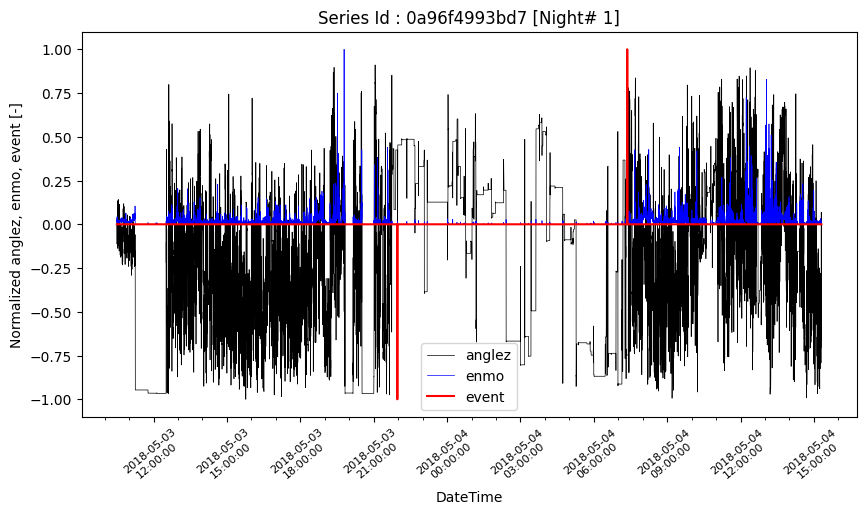

###  Control chart: 0a96f4993bd7, night 2

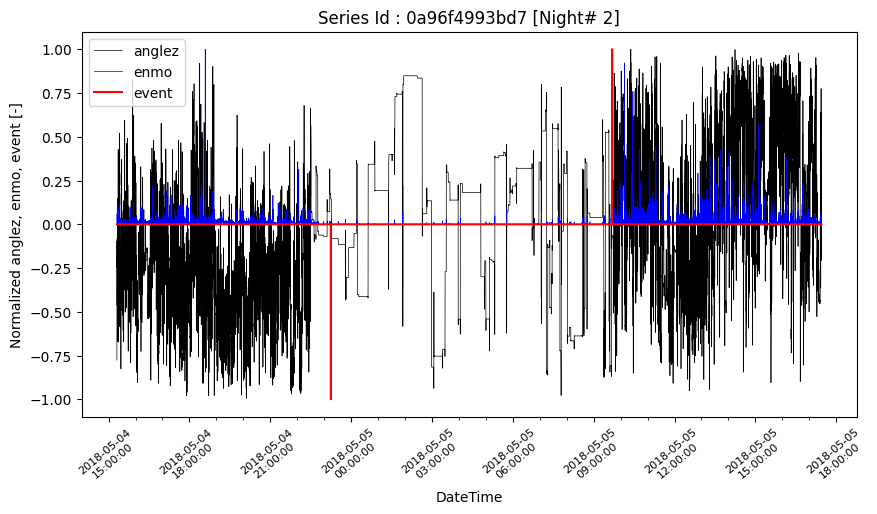

###  Control chart: 0a96f4993bd7, night 3

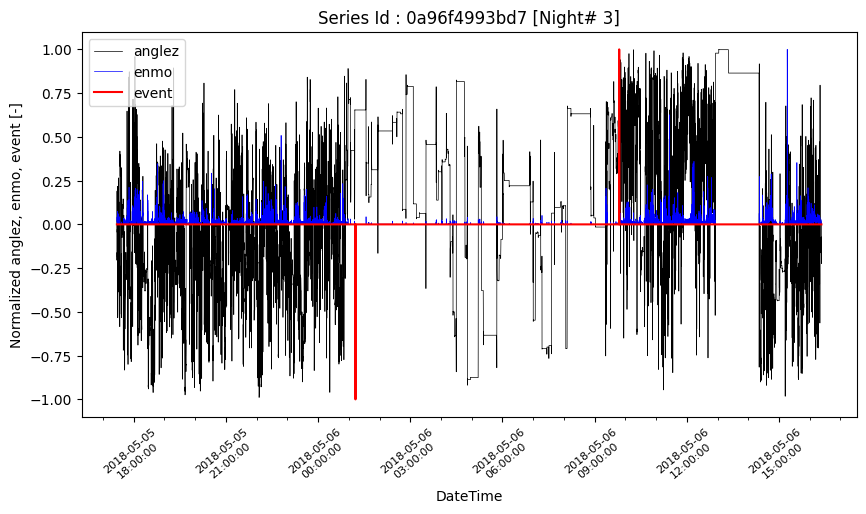

###  Control chart: 0a96f4993bd7, night 4

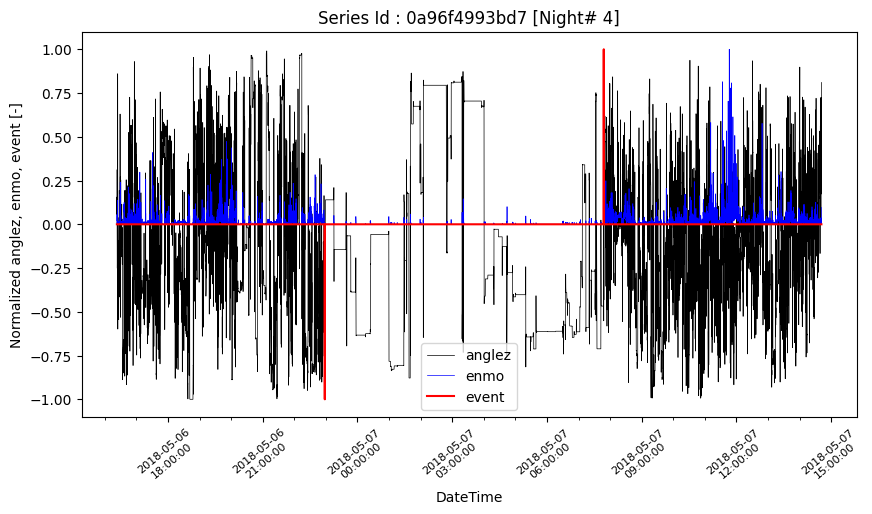

###  Control chart: 0a96f4993bd7, night 5

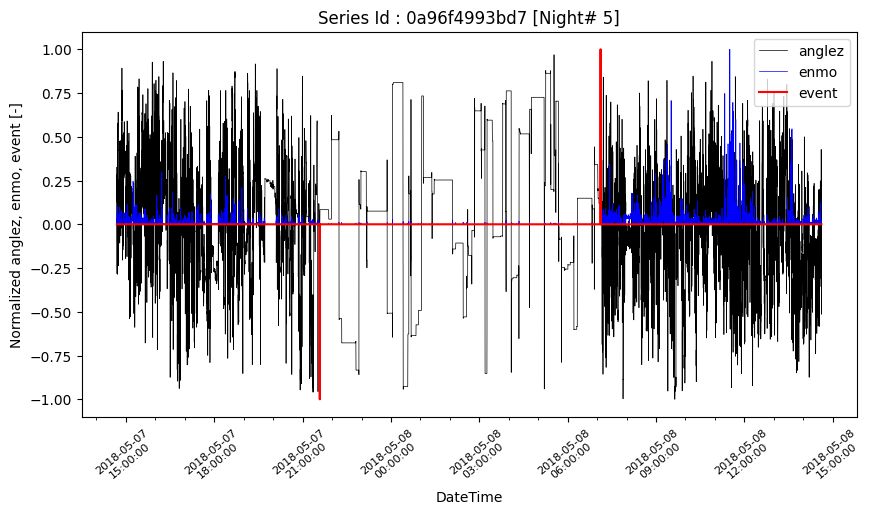

###  Control chart: 0a96f4993bd7, night 6

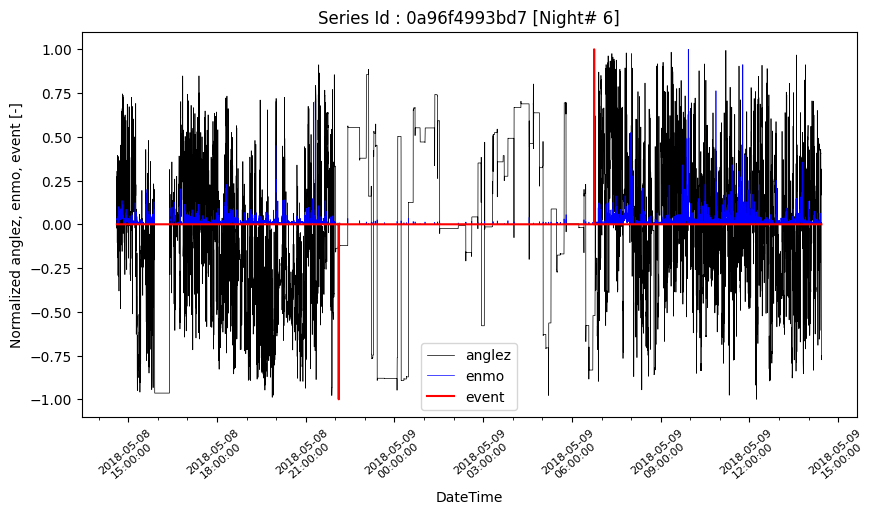

###  Control chart: 0a96f4993bd7, night 7

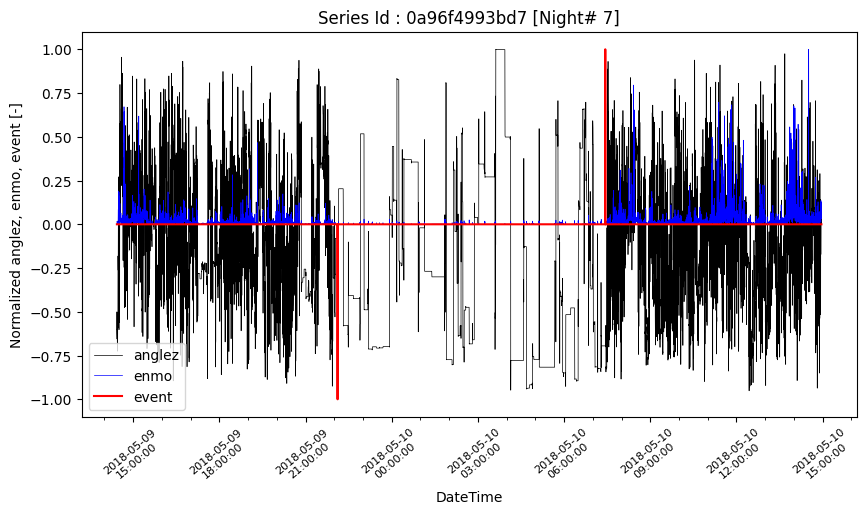

###  Control chart: 0a96f4993bd7, night 8

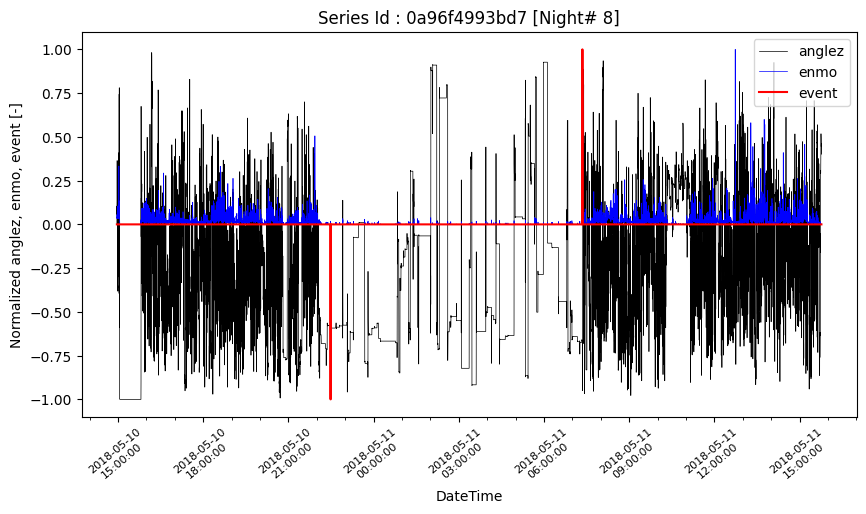

###  Control chart: 0a96f4993bd7, night 9

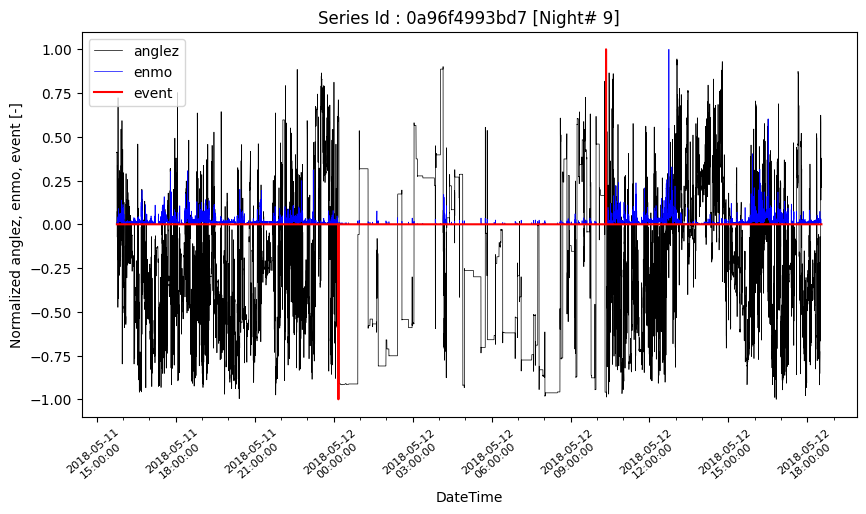

###  Control chart: 0a96f4993bd7, night 10

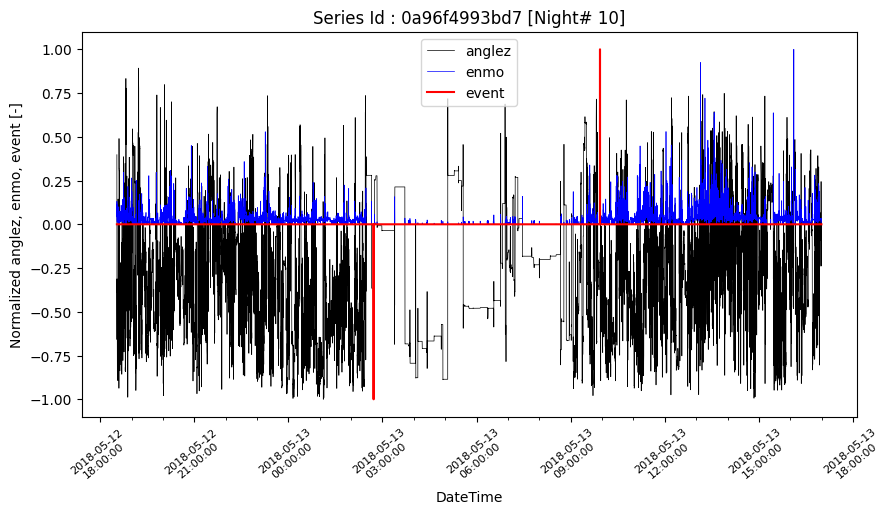

###  Control chart: 0a96f4993bd7, night 11

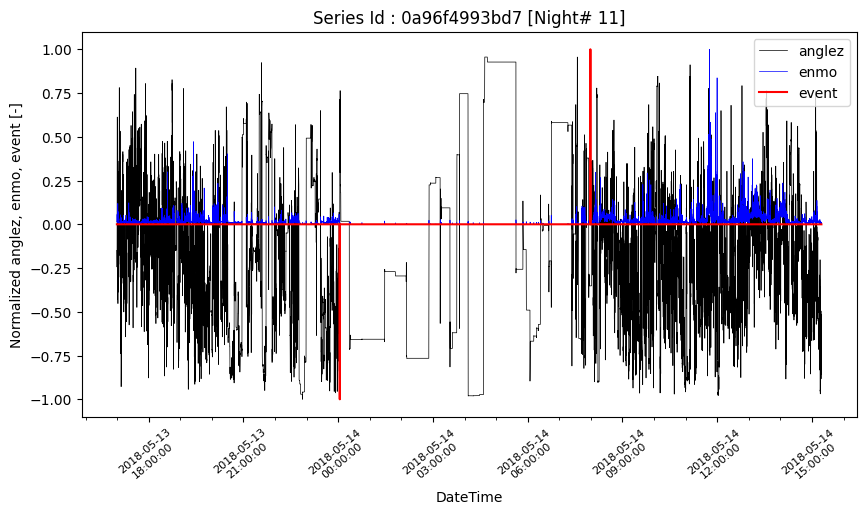

###  Control chart: 0a96f4993bd7, night 12

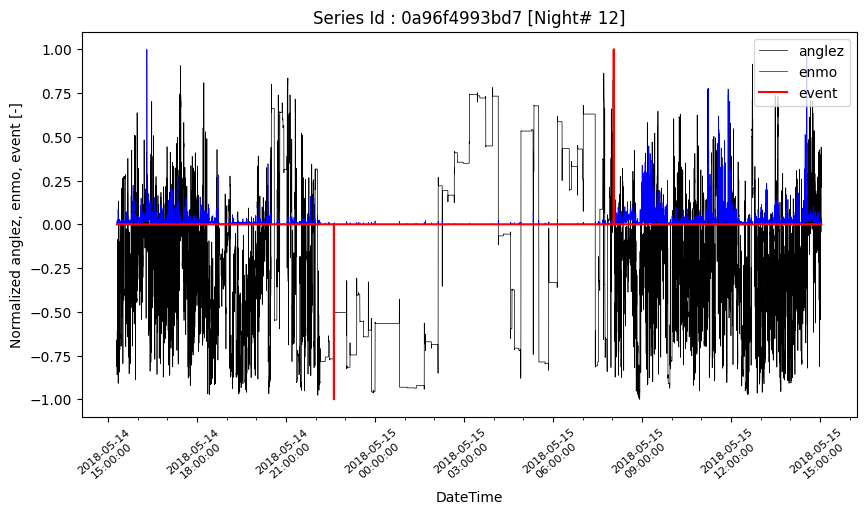

###  Control chart: 0a96f4993bd7, night 13

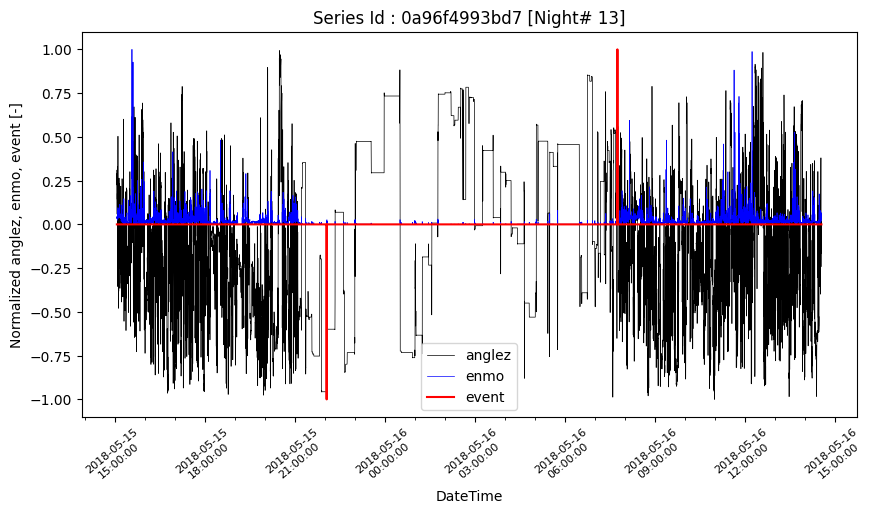

###  Control chart: 0a96f4993bd7, night 14

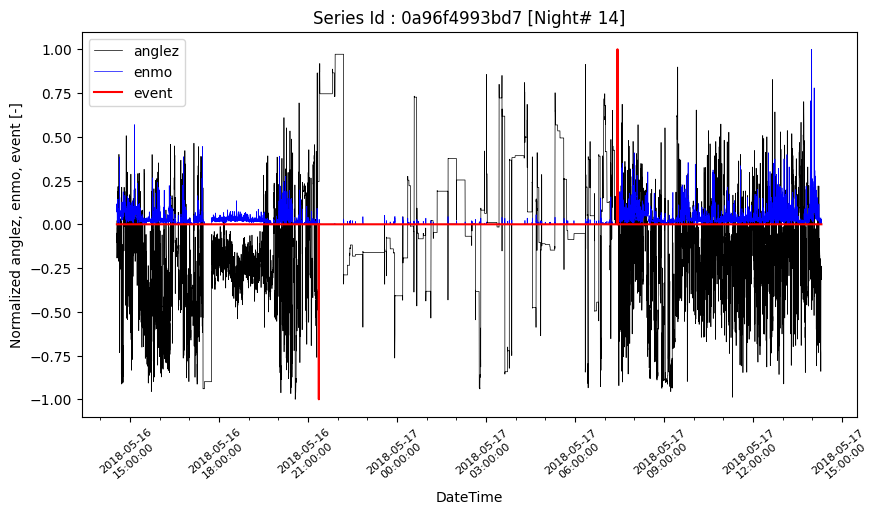

###  Control chart: 0a96f4993bd7, night 15

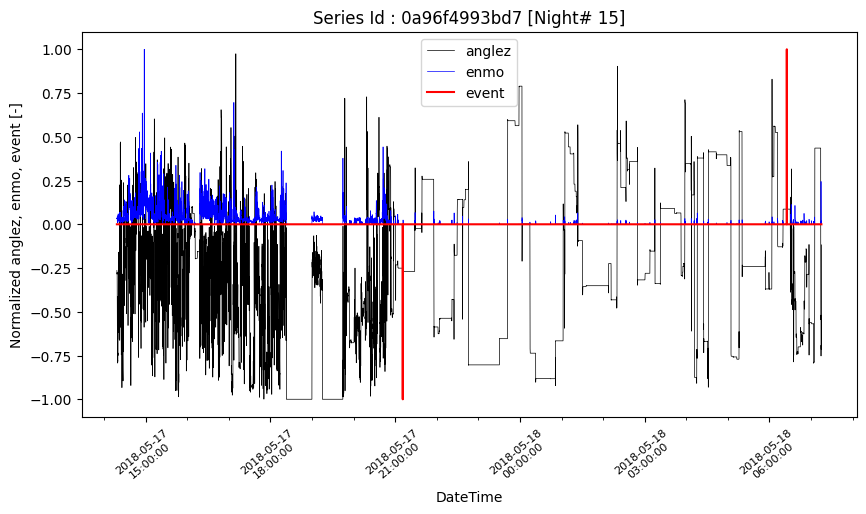

In [75]:
series_id = '0a96f4993bd7'
visualize_nights_ts(series_id)

In [76]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 52370 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Nights View: Series '08db4255286f'</div>

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:74: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:75: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_20/3261353427.py:76: SettingWithCopyWarning:


A value is trying

###  Control chart: 08db4255286f, night 1

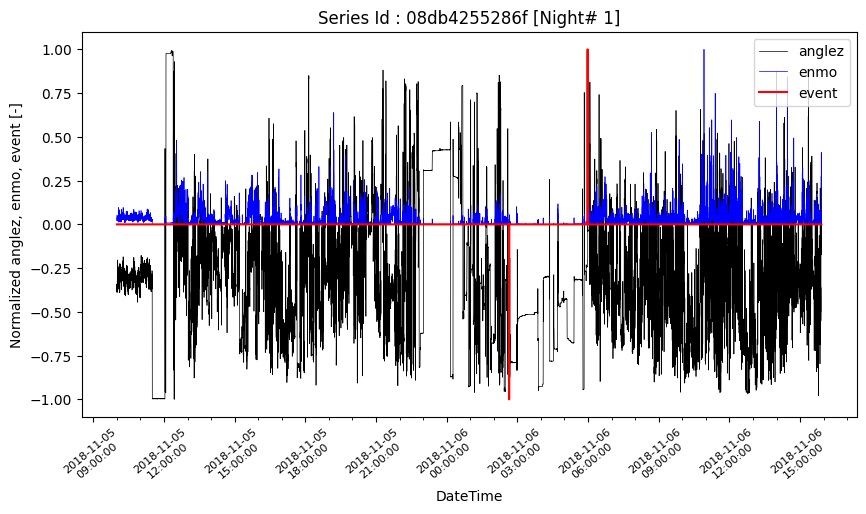

###  Control chart: 08db4255286f, night 2

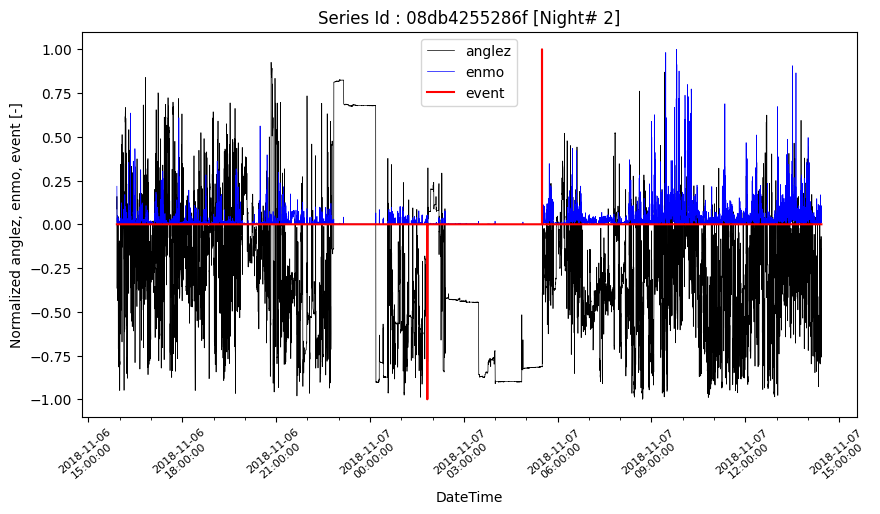

###  Control chart: 08db4255286f, night 3

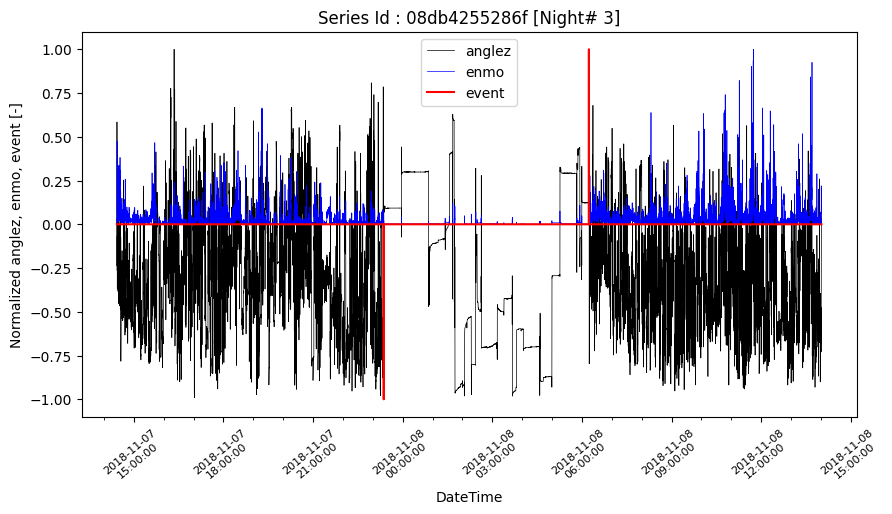

###  Control chart: 08db4255286f, night 4

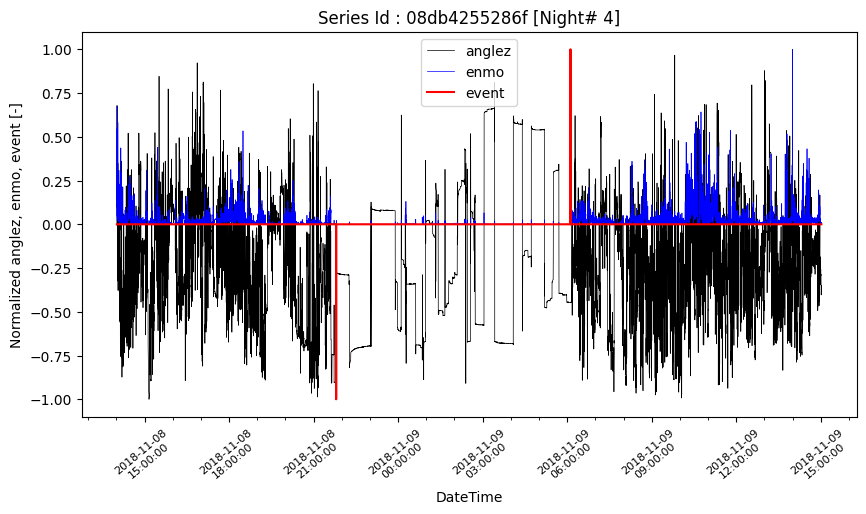

###  Control chart: 08db4255286f, night 5

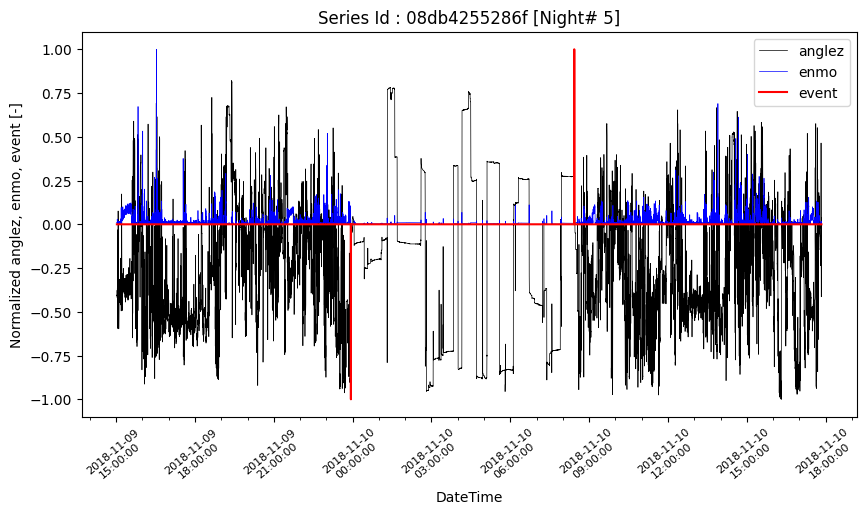

###  Control chart: 08db4255286f, night 6

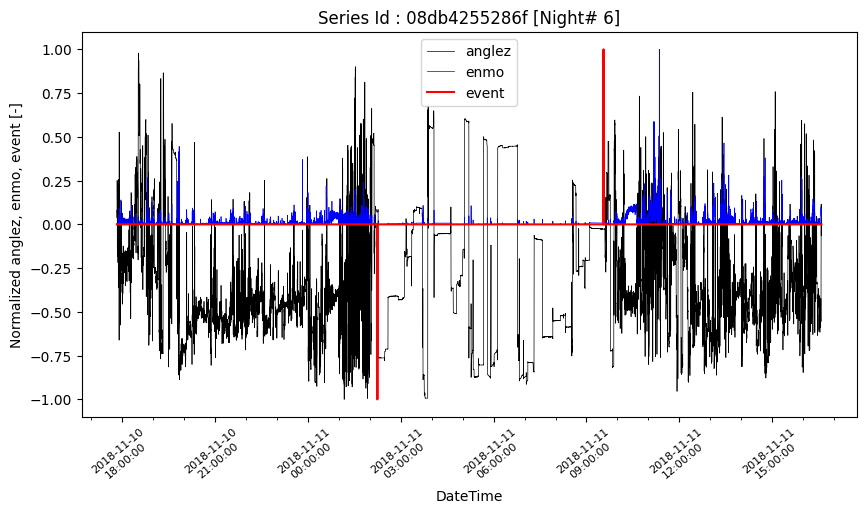

###  Control chart: 08db4255286f, night 7

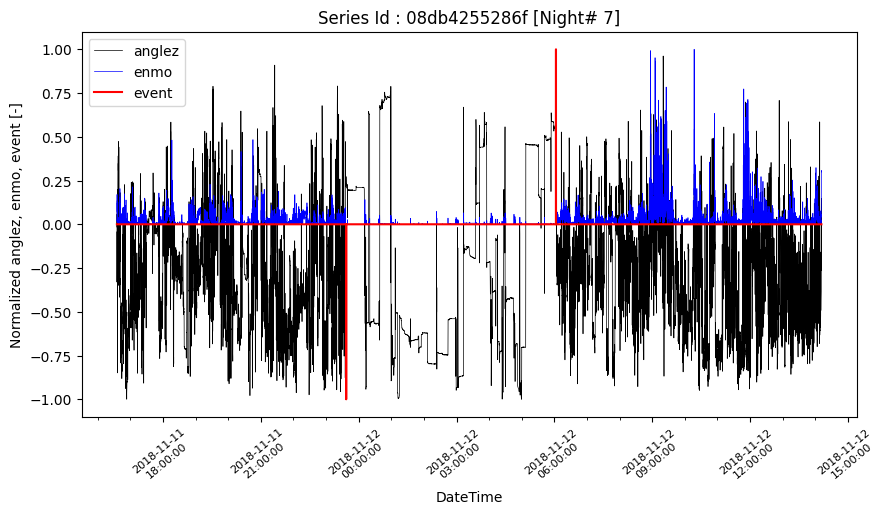

###  Control chart: 08db4255286f, night 8

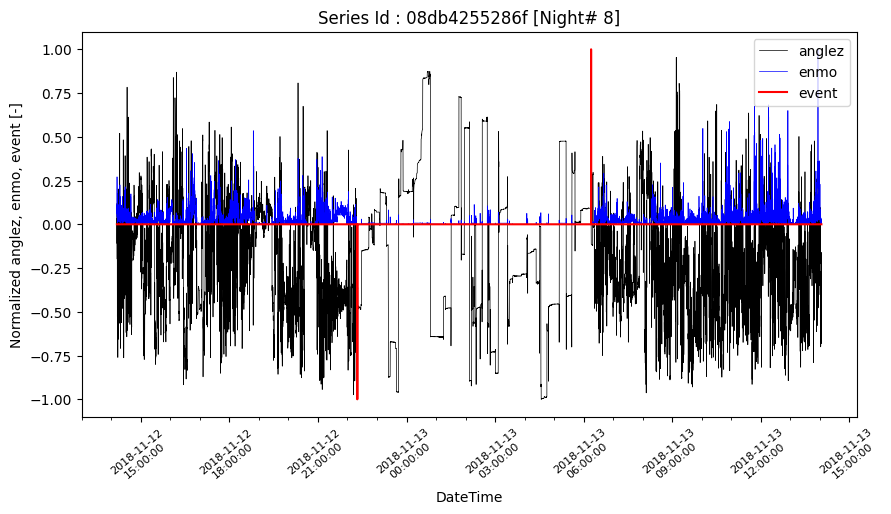

###  Control chart: 08db4255286f, night 9

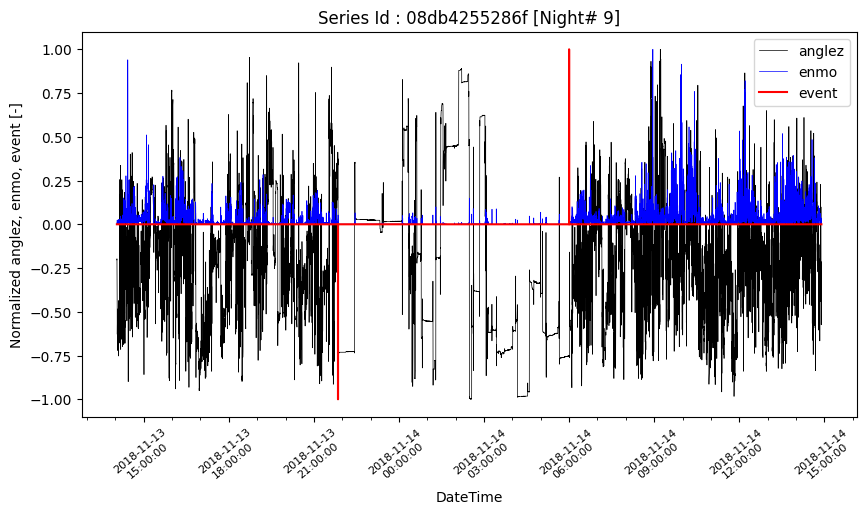

###  Control chart: 08db4255286f, night 10

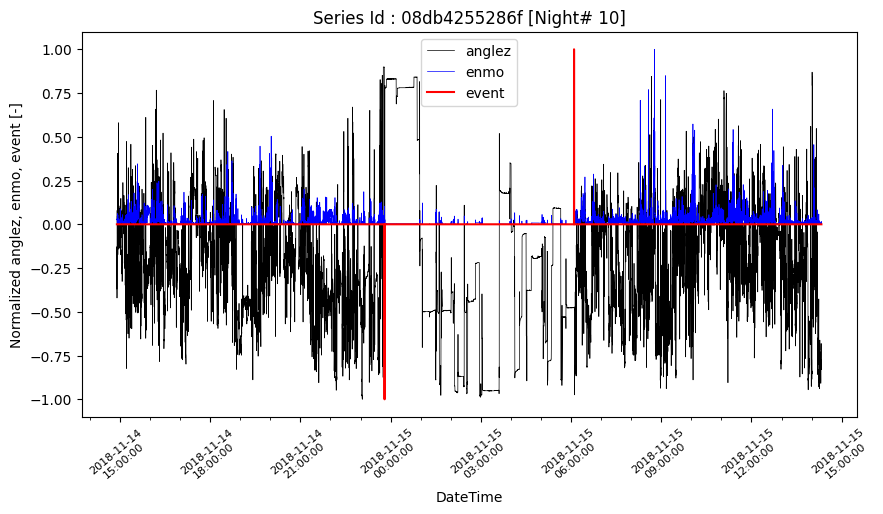

###  Control chart: 08db4255286f, night 11

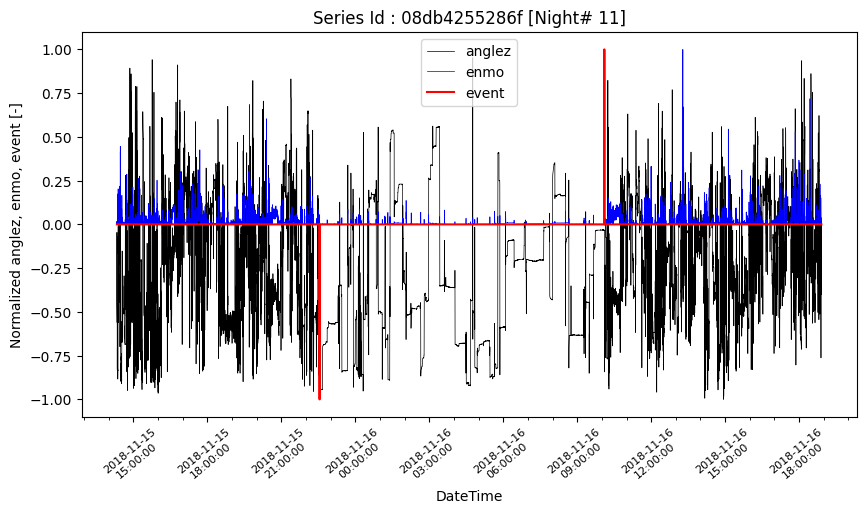

###  Control chart: 08db4255286f, night 12

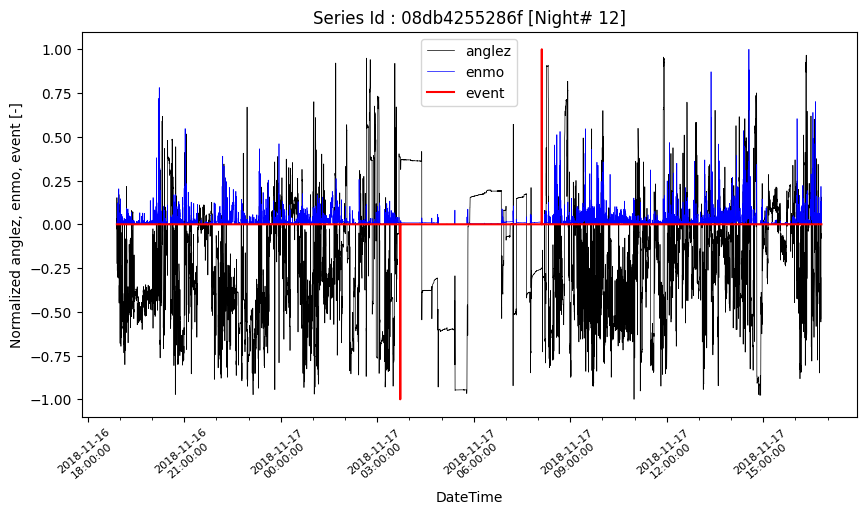

###  Control chart: 08db4255286f, night 13

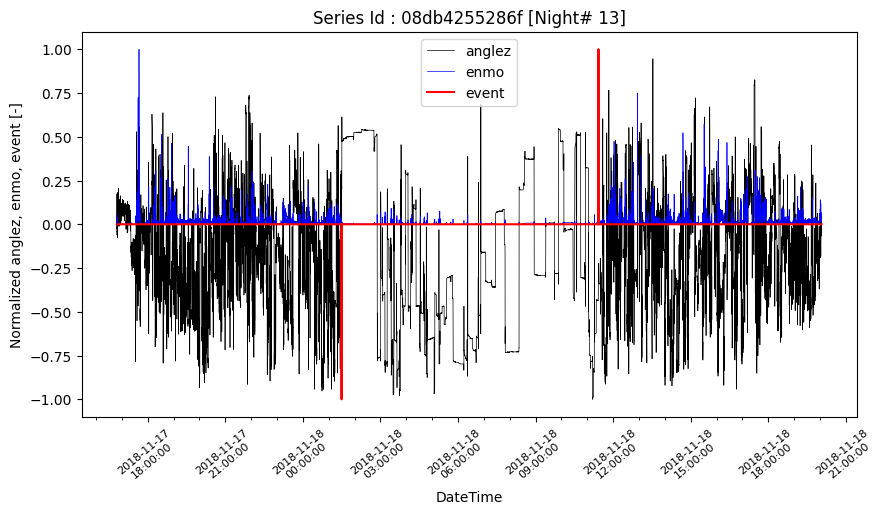

###  Control chart: 08db4255286f, night 14

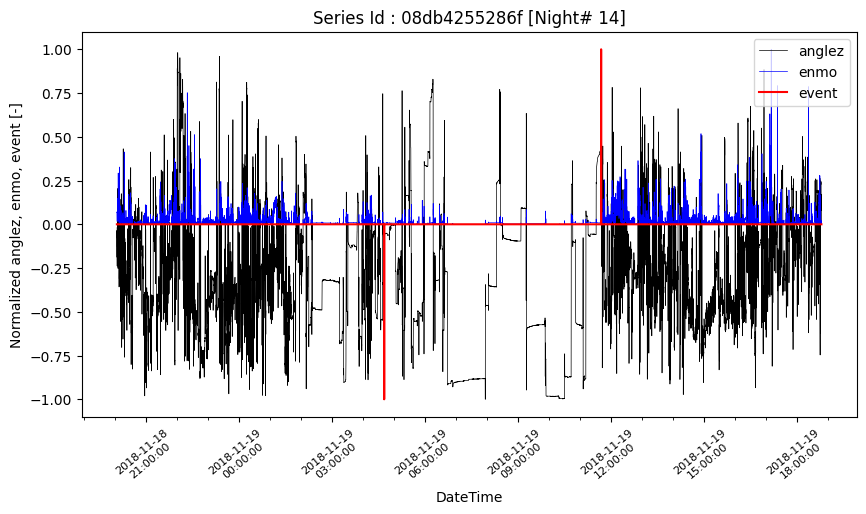

###  Control chart: 08db4255286f, night 15

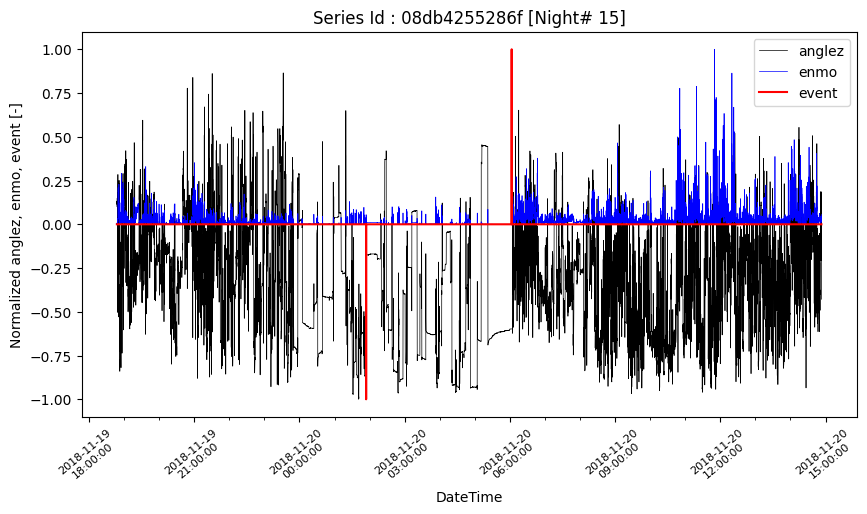

###  Control chart: 08db4255286f, night 16

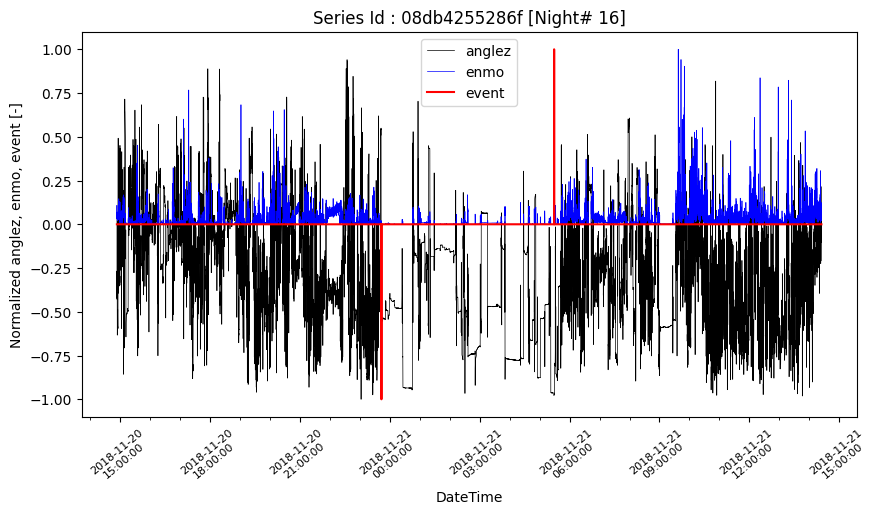

###  Control chart: 08db4255286f, night 17

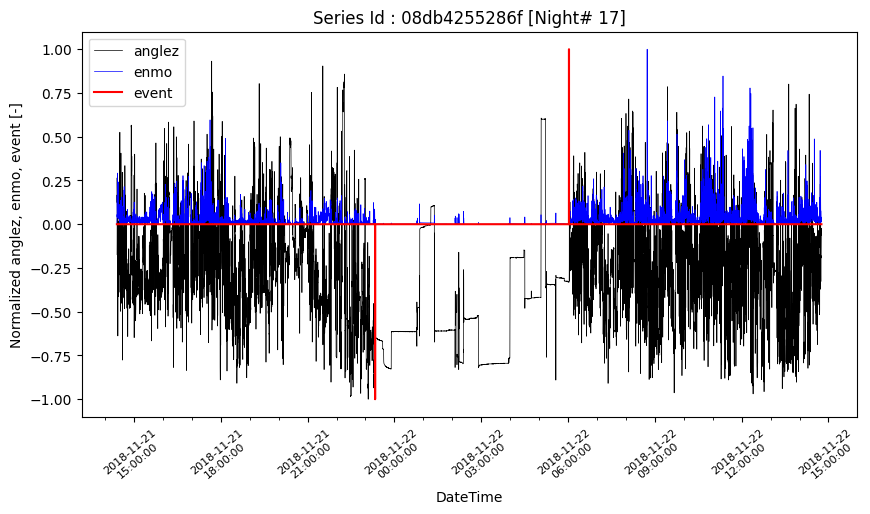

###  Control chart: 08db4255286f, night 18

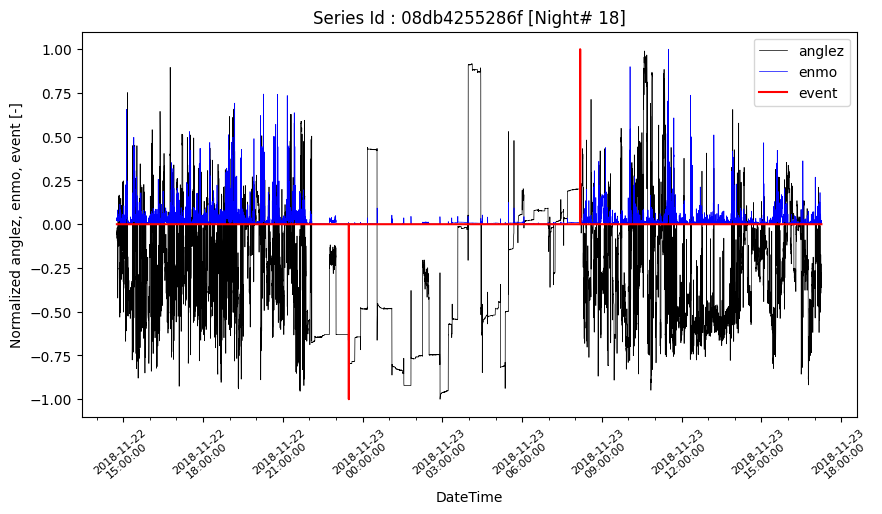

###  Control chart: 08db4255286f, night 19

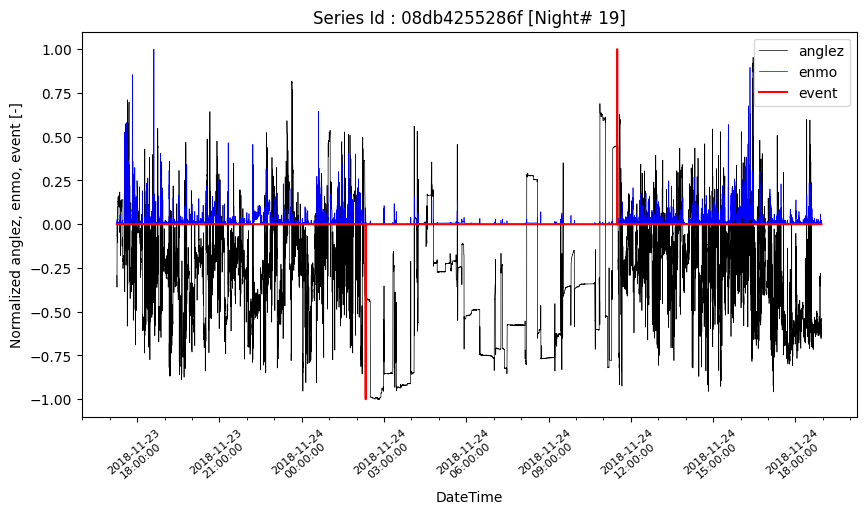

###  Control chart: 08db4255286f, night 20

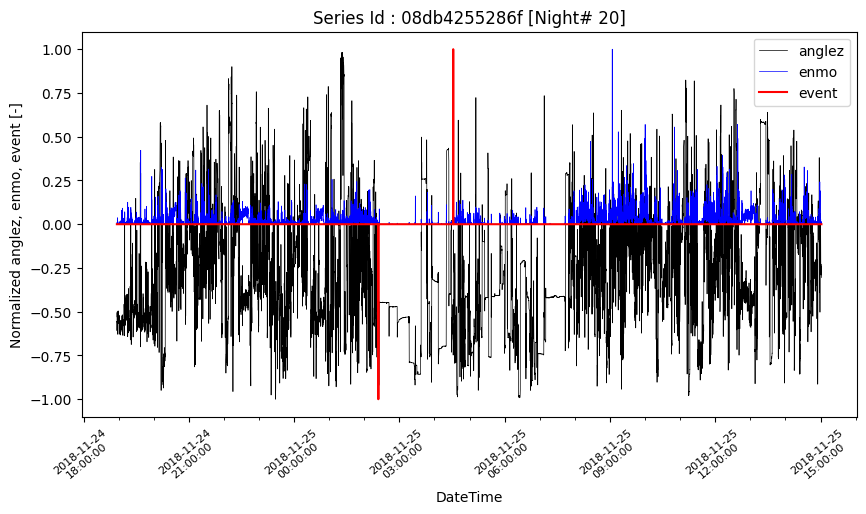

###  Control chart: 08db4255286f, night 21

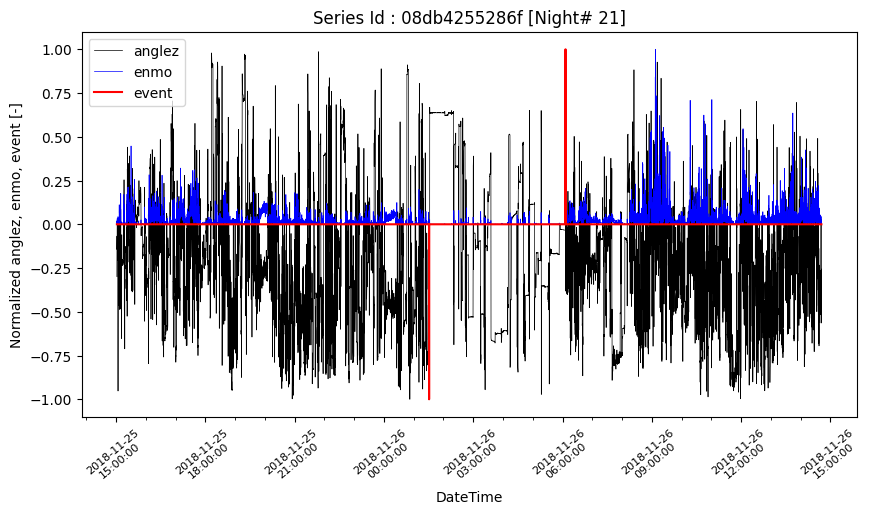

###  Control chart: 08db4255286f, night 22

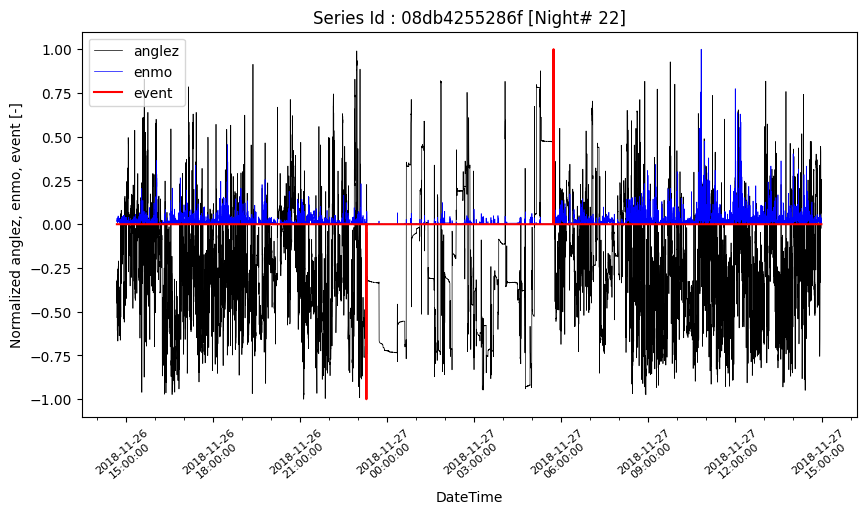

###  Control chart: 08db4255286f, night 23

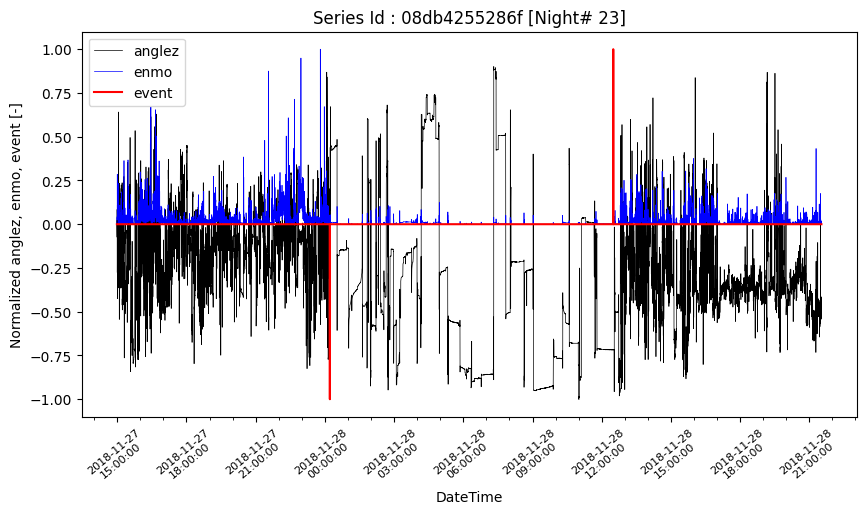

###  Control chart: 08db4255286f, night 24

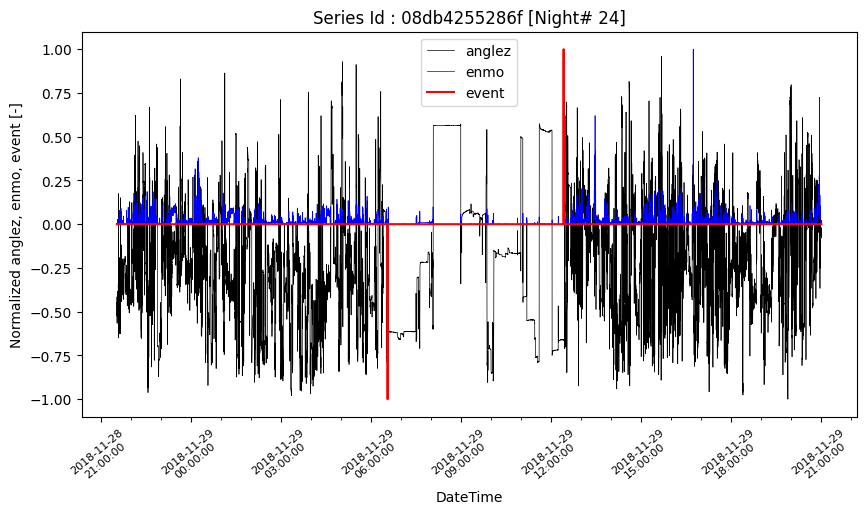

###  Control chart: 08db4255286f, night 25

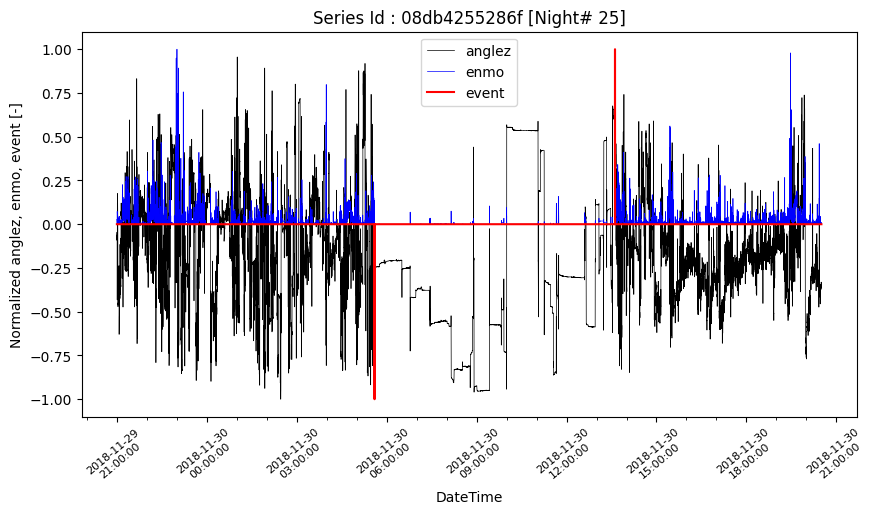

In [77]:
series_id = '08db4255286f'
visualize_nights_ts(series_id)

In [78]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 148615 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Temporal View: OHLC Resampling of Training Series TS</div>


In finance (and some other industries as well), a popular way to aggregate a time series is to implement **Open-high-low-close(OHLC) resampling**.

The essence of this technique is to to compute four values for each bucket (time interval) as follows
- the *first(open)* value, 
- the *last(close)* value, 
- the *maximum(high)* value, and 
- the *minimal(low)* values 

Let's apply OHLC resampling to visualize the correlated *anglez, enmo, and event* trends on a single diagram, for selected training series.

In [79]:
# inspired by https://www.kaggle.com/code/fengvm/accelerate-time-series-data-processing
def plot_series_ohlc(series_id, freq='1min', nights=2):
    """
    freq = '1min' : Sampling frequency, Optional 5s, 1min, 5min, 1H
    """
    series_df  = get_series_data(series_id)
    series = series_df[series_df['night'] <= nights] # Only display data for a specified number of nights (days)
    series = series.set_index('date_time')
    
    tss_anglez = series['anglez'].resample(freq).ohlc()
    tss_enmo = series['enmo'].resample(freq).ohlc()
        
    fig = make_subplots(rows=3, cols=1, subplot_titles=('<b>OHLC: anglez</b>',
                                                    '<b>OHLC: enmo</b>',
                                                    '<b>Event timeline</b>',
                                                   ))

    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['open'], name='anglez: opening'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['high'], name='anglez: high'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['low'], name='anglez: low'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['close'], name='anglez: close'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['open'], name='enmo: open'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['high'], name='enmo: high'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['low'], name='enmo: low'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['close'], name='enmo: close'), row=2, col=1)
    fig.add_trace(go.Scatter(x=series.index, y=series['event'], name='events'), row=3, col=1)
                                
    # Update visual layout
    fig.update_layout(
        showlegend=True,
        width=600,
        height=400,
        autosize=False,
        margin=dict(t=15, b=0, l=5, r=5),
        template="plotly_white",
        colorway=px.colors.qualitative.Prism ,
    )

    # update font size at the axes
    fig.update_coloraxes(colorbar_tickfont_size=10)
    # Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
    fig.update_annotations(font_size=12)
    # Reduce opacity
    fig.update_traces(opacity=0.75)
    
    return fig

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">OHLC View: Series '08db4255286f'</div>

Let's build OHLC charts for initial *5* nights in series *'08db4255286f'*, resampling by the *15-min* intervals.

In [80]:
series_id = '08db4255286f'
fig = plot_series_ohlc(series_id, freq='15min', nights=5)
fig.show()

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



As we can see from the charts above, 
- curves of high and low *anglez* display drastic going up around *wakeup* events
- curves of high and low *anglez* display going down around *onset* events
- curves of high and low *enmo* display moderate going up around *wakeup* events
- curves of high and low *enmo* display going down around *onset* events

In [81]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 975 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">OHLC View: Series '0a96f4993bd7'</div>

Let's build OHLC charts for initial *5* nights in series *'0a96f4993bd7'*, resampling by the *15-min* intervals.

In [82]:
series_id = '0a96f4993bd7'
fig = plot_series_ohlc(series_id, freq='15min', nights=5)
fig.show()

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [83]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 891 objects.


We can observe the same trends as above.

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">OHLC Resampling of Test Series Data</div>

In [84]:
def plot_test_series_ohlc(series_id, freq='1min'):
    """
    freq = '1min' : Sampling frequency, Optional 5s, 1min, 5min, 1H
    """
    series  = get_test_series_data(series_id)

    series = series.set_index('date_time')
    
    tss_anglez = series['anglez'].resample(freq).ohlc()
    tss_enmo = series['enmo'].resample(freq).ohlc()
        
    fig = make_subplots(rows=2, cols=1, subplot_titles=(
                            '<b>OHLC: anglez</b>',
                            '<b>OHLC: enmo</b>',
    ))

    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['open'], name='anglez: opening'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['high'], name='anglez: high'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['low'], name='anglez: low'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_anglez.index, y=tss_anglez['close'], name='anglez: close'), row=1, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['open'], name='enmo: open'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['high'], name='enmo: high'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['low'], name='enmo: low'), row=2, col=1)
    fig.add_trace(go.Scatter(x=tss_enmo.index, y=tss_enmo['close'], name='enmo: close'), row=2, col=1)
                                
    # Update visual layout
    fig.update_layout(
        showlegend=True,
        width=600,
        height=400,
        autosize=False,
        margin=dict(t=15, b=0, l=5, r=5),
        template="plotly_white",
        colorway=px.colors.qualitative.Prism ,
    )

    # update font size at the axes
    fig.update_coloraxes(colorbar_tickfont_size=10)
    # Update font in the titles: Apparently subplot titles are annotations (Subplot font size is hardcoded to 16pt · Issue #985)
    fig.update_annotations(font_size=12)
    # Reduce opacity
    fig.update_traces(opacity=0.75)
    
    return fig

In [85]:
for series_id in test_series_id_list:
    display(Markdown("## <div style='font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%'>OHLC Resampling: Series " + series_id + "</div>"  ))
    fig = plot_test_series_ohlc(series_id, freq='1min')
    fig.show()

## <div style='font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%'>OHLC Resampling: Series 0402a003dae9</div>

## <div style='font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%'>OHLC Resampling: Series 038441c925bb</div>

## <div style='font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%'>OHLC Resampling: Series 03d92c9f6f8a</div>

In [86]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 3333 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Polar View on Training Series Data</div>

In [87]:
def plot_polar_views(series_id):

    series_df  = get_series_data(series_id)
    fig1 = px.scatter_polar(series_df, r="enmo", theta="anglez",
                       color="event", symbol="event", size="enmo",
                       color_discrete_sequence=px.colors.sequential.Turbo,
                      title=f"Polar view on enmo/anglez: series {series_id}, all observations")
    
    
    events_df = series_df[series_df['event'] != 0]
    fig2 = px.scatter_polar(events_df, r="enmo", theta="anglez",
                       color="event", symbol="event", size="enmo",
                       color_discrete_sequence=px.colors.sequential.Turbo,
                      title=f"Polar view on enmo/anglez at event spots: series {series_id}, (onset=-1, awake=1)")
    
    return fig1, fig2

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Polar View: Series '0a96f4993bd7'</div>

In [88]:
series_id  = '0a96f4993bd7'
fig1, fig2 = plot_polar_views(series_id)
display(Markdown('###  Entire records for the series'))
fig1.show()
display(Markdown('###  Wakeup/Onset spots for the series'))
fig2.show()

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



###  Entire records for the series

###  Wakeup/Onset spots for the series

In [89]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 287 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Polar View: Series '08db4255286f'</div>

In [90]:
series_id  = '08db4255286f'
fig1, fig2 = plot_polar_views(series_id)
display(Markdown('###  Entire records for the series'))
fig1.show()
display(Markdown('###  Wakeup/Onset spots for the series'))
fig2.show()

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



###  Entire records for the series

###  Wakeup/Onset spots for the series

In [91]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1714 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Polar View: Series '1087d7b0ff2e'</div>

In [92]:
series_id  = '1087d7b0ff2e'
fig1, fig2 = plot_polar_views(series_id)
display(Markdown('###  Entire records for the series'))
fig1.show()
display(Markdown('###  Wakeup/Onset spots for the series'))
fig2.show()

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



###  Entire records for the series

###  Wakeup/Onset spots for the series

In [93]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 1707 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Spectral Analysis of Training Series Data</div>

As mentioned by [@andradaolteanu]() in her [notebook](https://www.kaggle.com/code/andradaolteanu/zzz-in-depth-explore-with-spectrograms-lines), this competition can be potentially tackled from multiple angles:

- it can be set up as a tabular classification problem (the most popular approach in the public notebooks so far)
- it can be an LSTM-RNN classifier using the sequential (time) data
- it can be even a computer vision problem (*if we convert the time data to spectrograms*)

This chapter is dedicated to building and visualizing the spectrograms for the *anglez/enmo* data in the training seria.

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Understanding spectrograms</div>

A spectrogram is a visual representation of the Short-Time Fourier Transform (see [this thread](https://stackoverflow.com/questions/29321696/what-is-a-spectrogram-and-how-do-i-set-its-parameters) for moree info). You can think of it as taking chunks of an input signal and applying a local Fourier Transform on each chunk. Each chunk has a specified width and you apply a Fourier Transform to this chunk. You should take note that each chunk has an associated frequency distribution. For each chunk that is centred at a specific time point in your time signal, you get a bunch of frequency components. The collection of all of these frequency components at each chunk and plotted all together is what is essentially a spectrogram.

The spectrogram is a 2D visual heat map where the horizontal axis represents the time of the signal and the vertical axis represents the frequency axis. What is visualized is an image where darker colours means that for a particular time point and a particular frequency, the lower in magnitude the frequency component is, the darker the colour. Similarly, the higher in magnitude the frequency component is, the lighter the colour.

In [94]:
# inspired by https://www.kaggle.com/code/andradaolteanu/zzz-in-depth-explore-with-spectrograms-lines#3.-Spectrogram-analysis
def create_spectrogram(value):
    
    # defines the width of each chunk in terms of samples
    # large window size -> better frequency resolution -> poor time localization
    window_size = 256 
    # ensures that each chunk has a certain number of samples 
    # that are overlapping for each chunk
    # default is 0.5*window
    overlap = 128
    # how many FFT points are desired to be computed per chunk
    # how fine-grained the frequency resolution will be
    nfft = 256 
    # sampling frequency of your signal
    # default is 1
    fs = 1.0 

    frequencies, times, Sxx = spectrogram(value, fs=fs, nperseg=window_size, 
                                          noverlap=overlap, nfft=nfft)
    return frequencies, times, Sxx


def build_spectrogram(series_id):
    
    series_data_df = get_series_data(series_id)
    for i in set(series_data_df['night']):
        spec_data = series_data_df[series_data_df['night']==i]
        display(Markdown('###  Spectrogram: ' + series_id + ', night ' + str(int(i)) ))
        
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 10))
        axs = [ax1, ax2]
        fig.suptitle(f'A night for id: {series_id}')
        
        k=0

        feat = 'anglez'
        f, t, s = create_spectrogram(spec_data[feat].values)
        axs[k].pcolormesh(t, f, 10 * np.log10(s), cmap="RdYlBu")
        axs[k].set_xlabel('Time (s)')
        axs[k].set_ylabel('Frequency (Hz)')
        axs[k].set_title(f'Spectrogram of {feat}')
        k = k+1
        
        feat = 'enmo'
        f, t, s = create_spectrogram(spec_data[feat].values)
        axs[k].pcolormesh(t, f, 10 * np.log10(s), cmap="RdYlBu")
        axs[k].set_xlabel('Time (s)')
        axs[k].set_ylabel('Frequency (Hz)')
        axs[k].set_title(f'Spectrogram of {feat}')
        
        plt.show()
    

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Spectrogram: Series '08db4255286f'</div>

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



###  Spectrogram: 08db4255286f, night 1

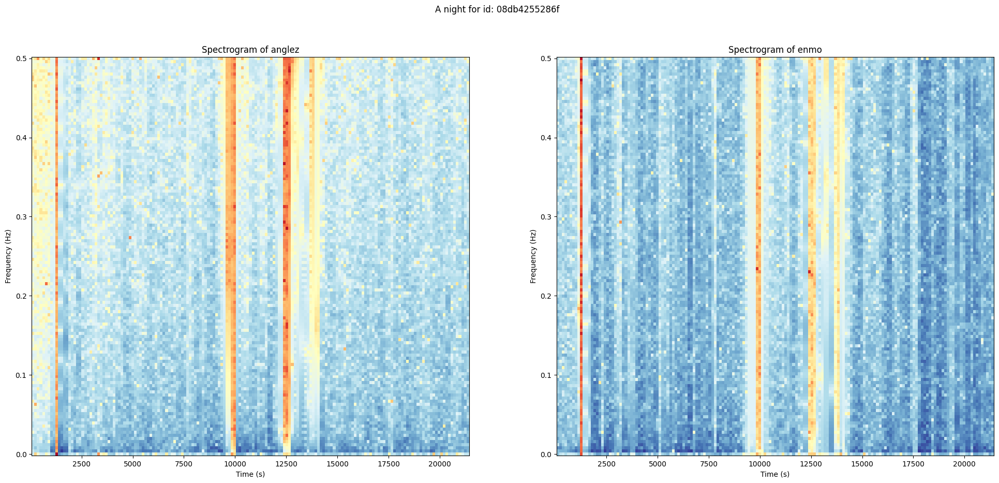

###  Spectrogram: 08db4255286f, night 2

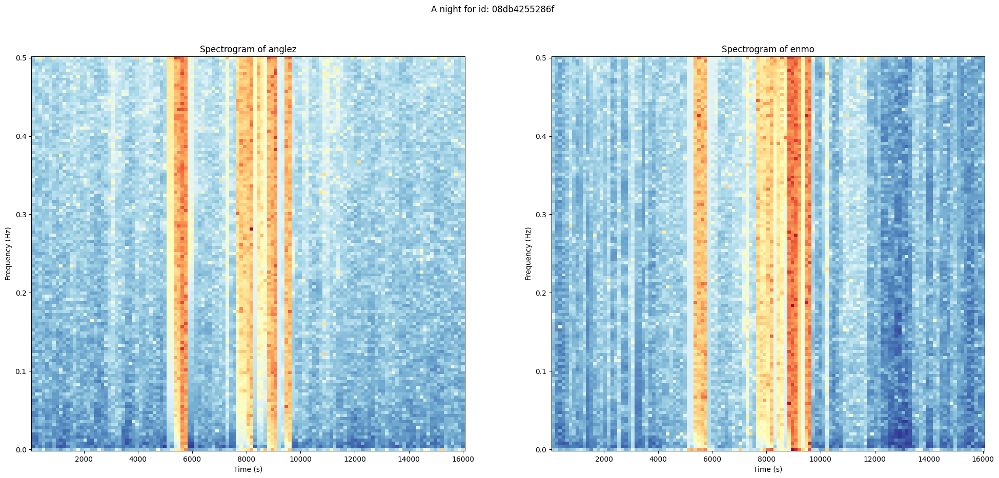

###  Spectrogram: 08db4255286f, night 3

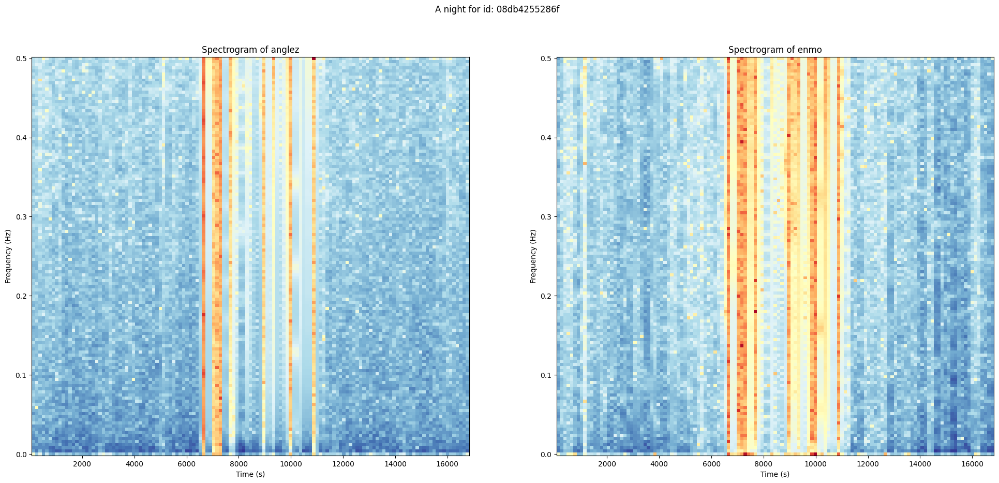

###  Spectrogram: 08db4255286f, night 4

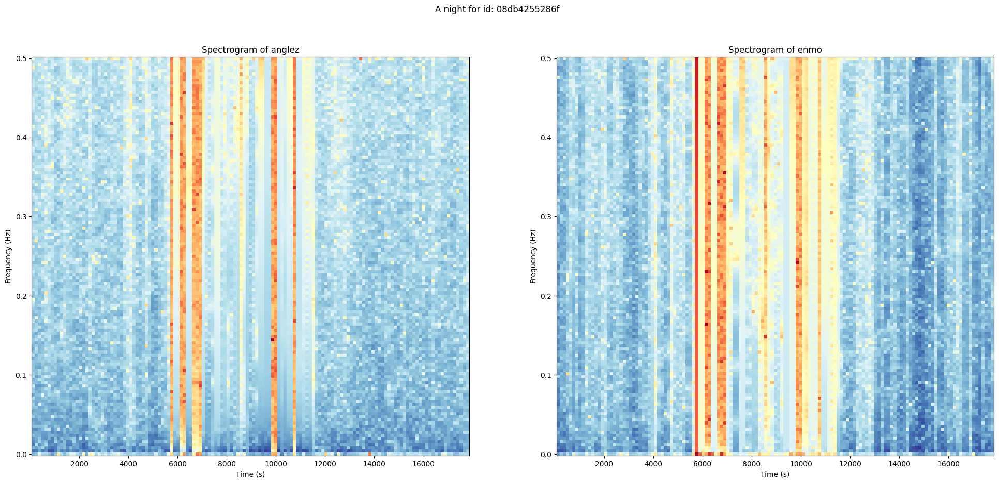

###  Spectrogram: 08db4255286f, night 5

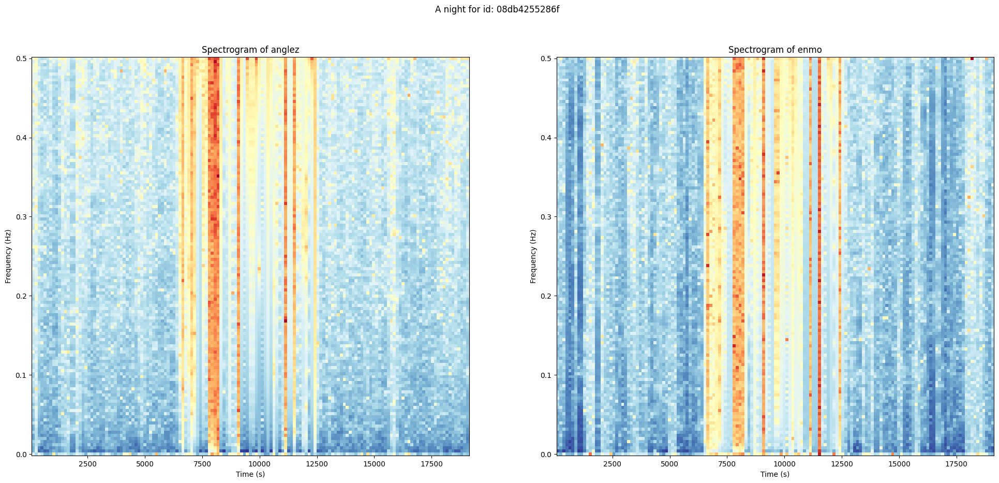

###  Spectrogram: 08db4255286f, night 6

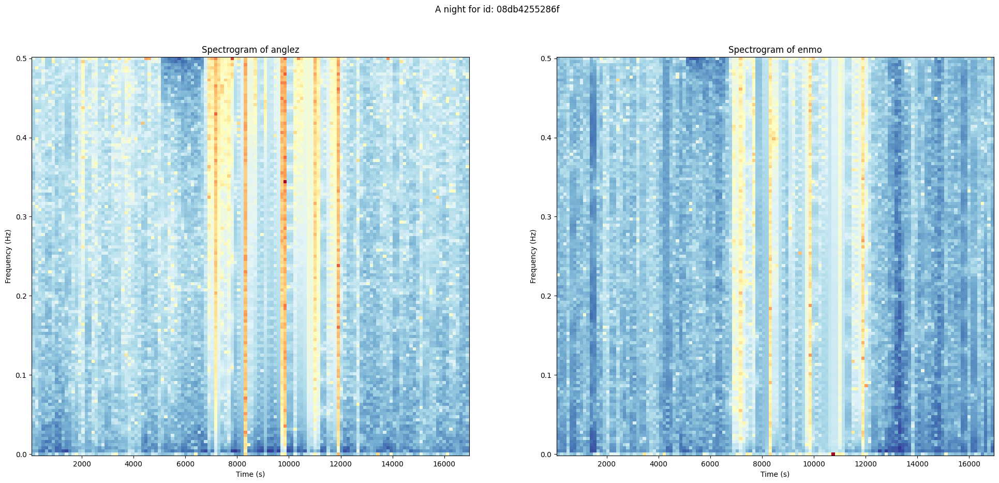

###  Spectrogram: 08db4255286f, night 7

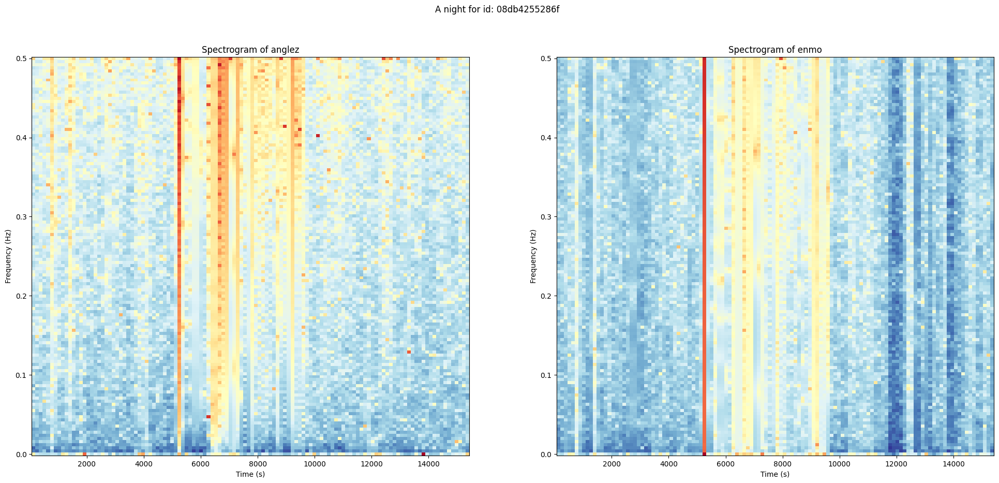

###  Spectrogram: 08db4255286f, night 8

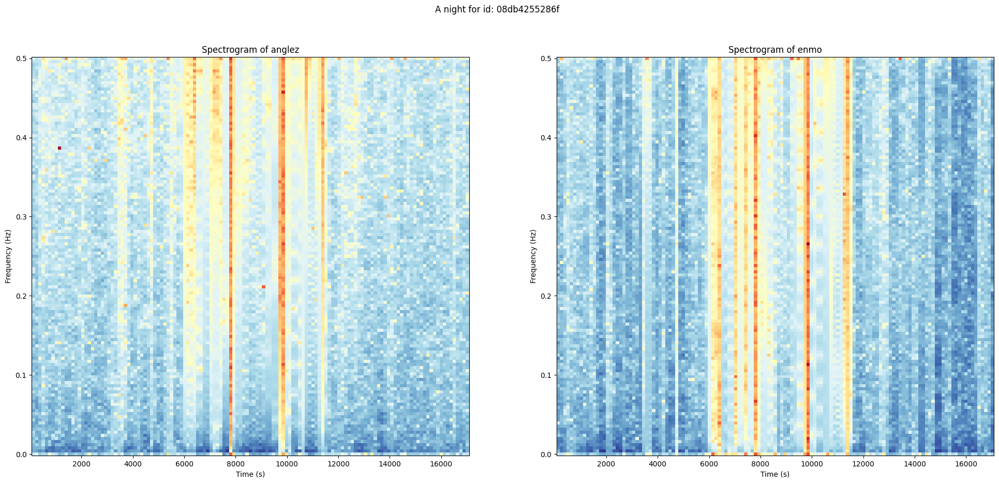

###  Spectrogram: 08db4255286f, night 9

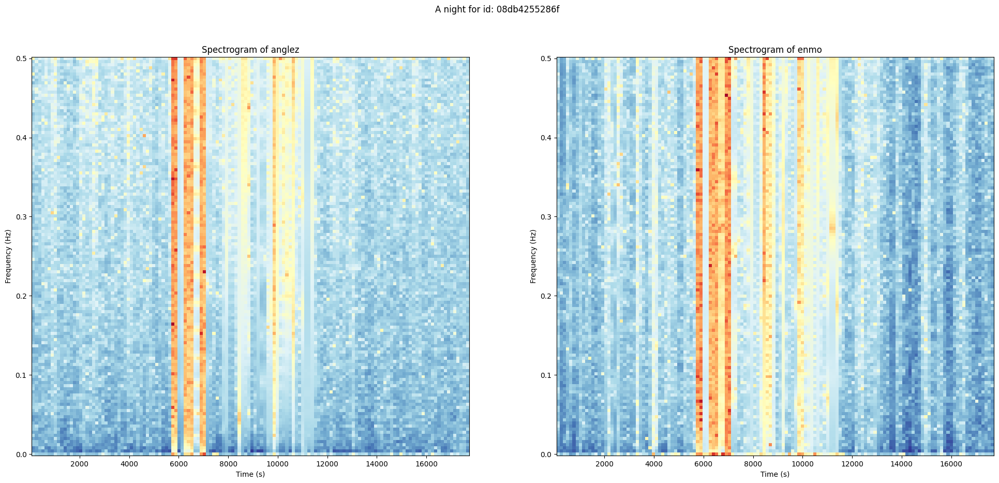

###  Spectrogram: 08db4255286f, night 10

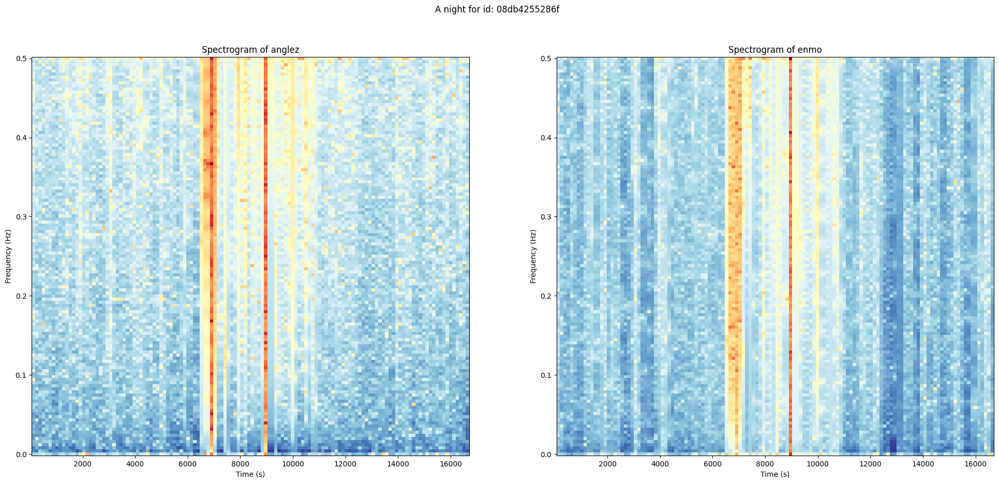

###  Spectrogram: 08db4255286f, night 11

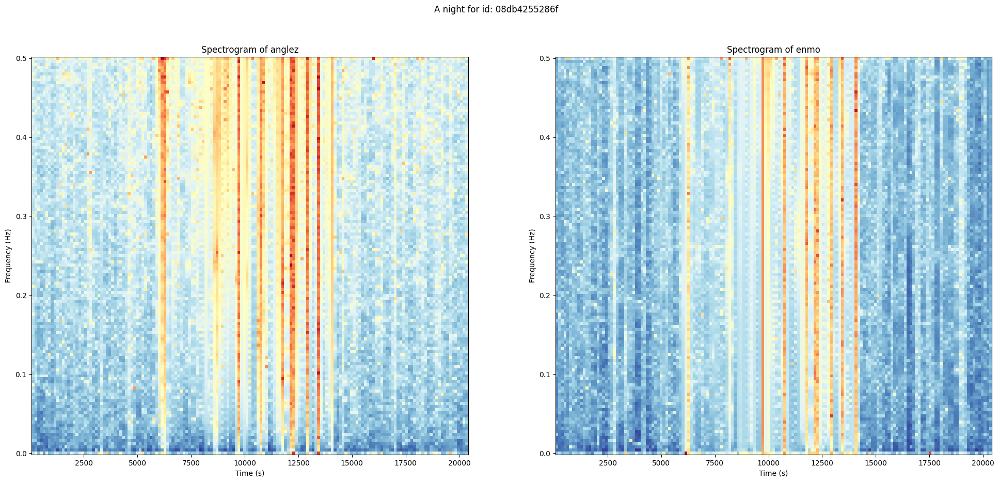

###  Spectrogram: 08db4255286f, night 12

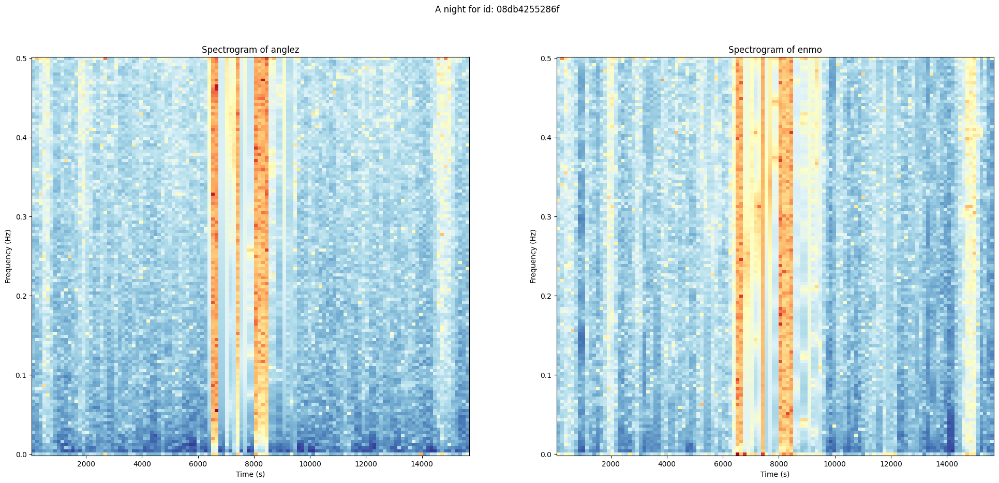

###  Spectrogram: 08db4255286f, night 13

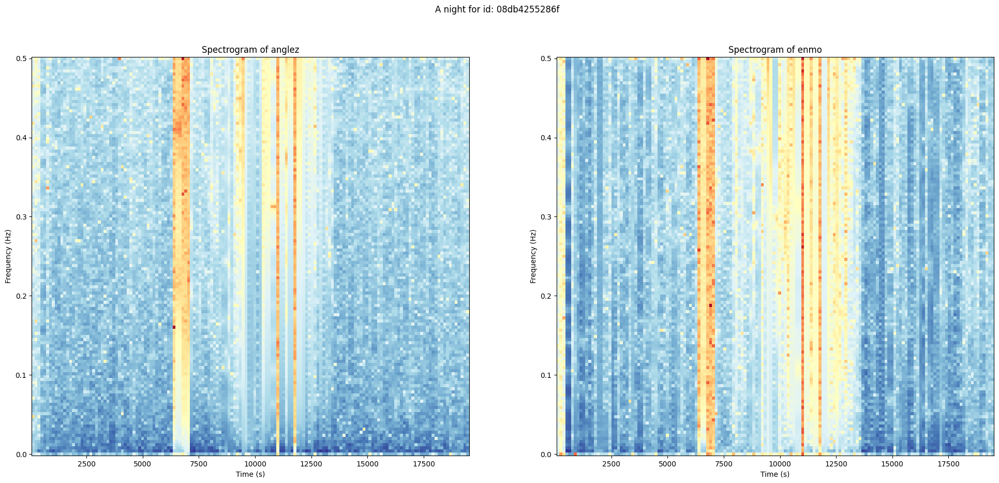

###  Spectrogram: 08db4255286f, night 14

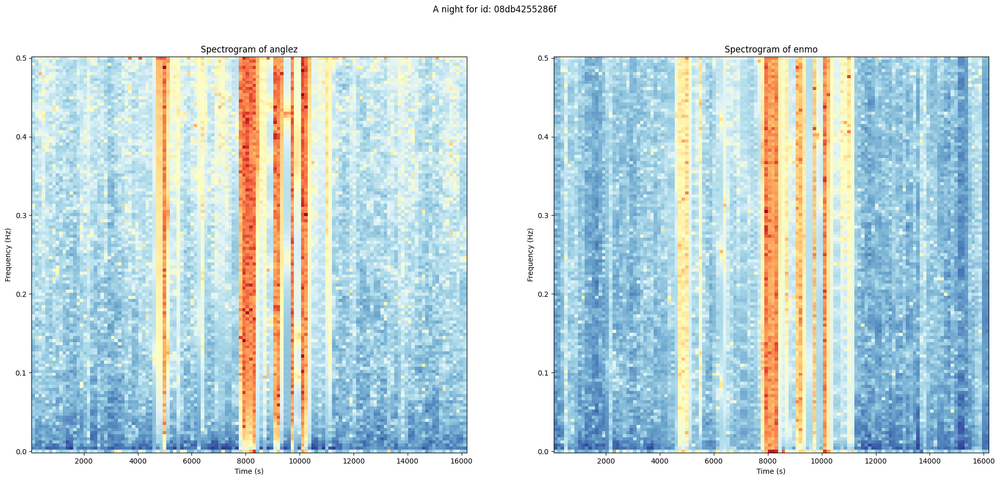

###  Spectrogram: 08db4255286f, night 15

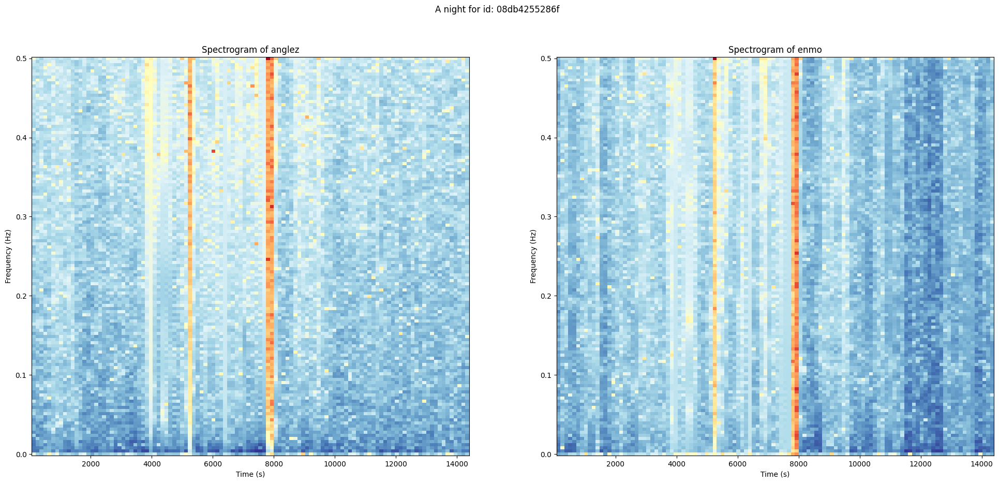

###  Spectrogram: 08db4255286f, night 16

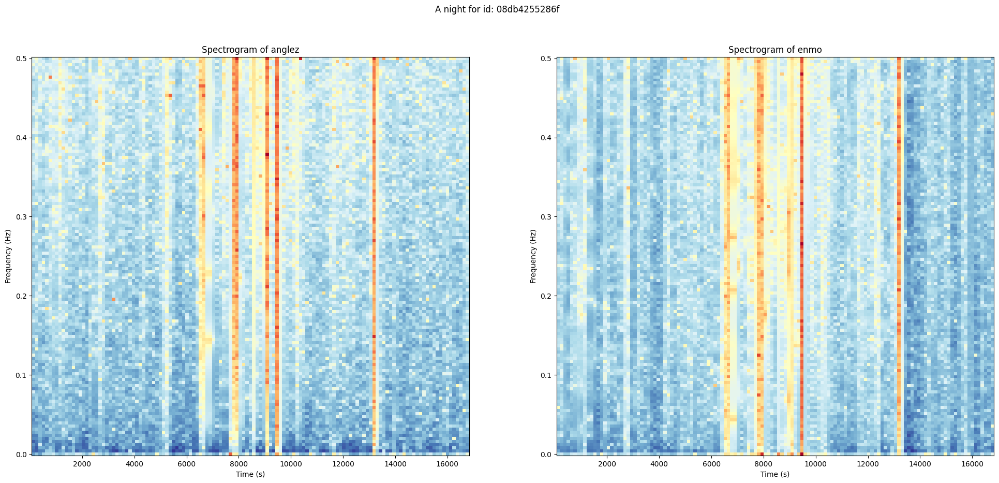

###  Spectrogram: 08db4255286f, night 17

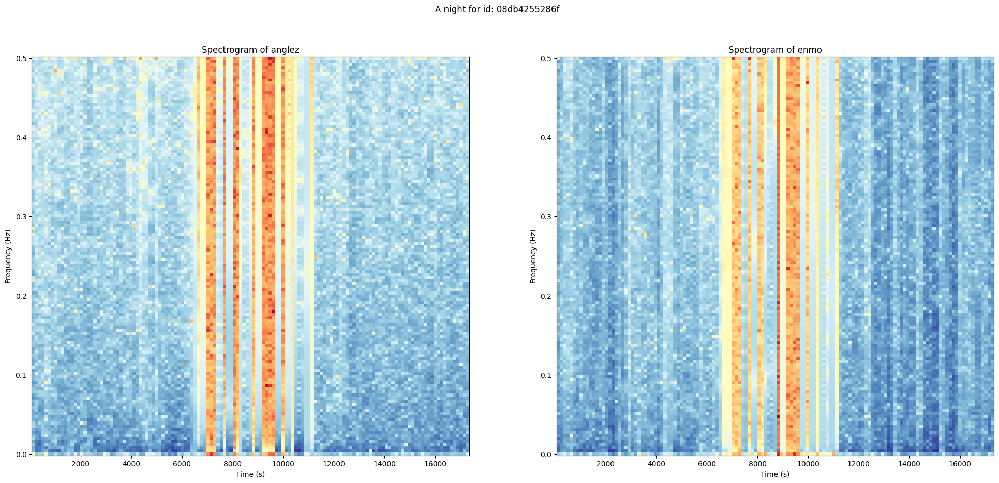

###  Spectrogram: 08db4255286f, night 18

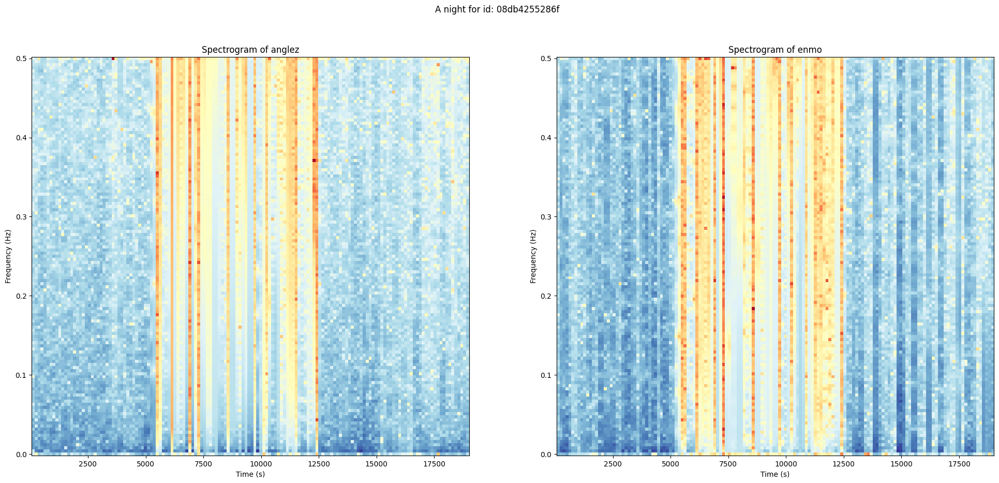

###  Spectrogram: 08db4255286f, night 19

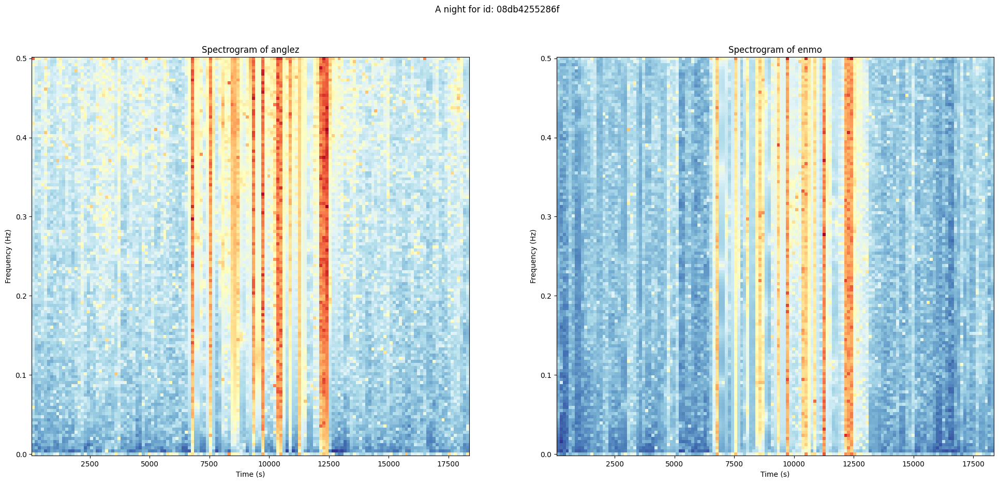

###  Spectrogram: 08db4255286f, night 20

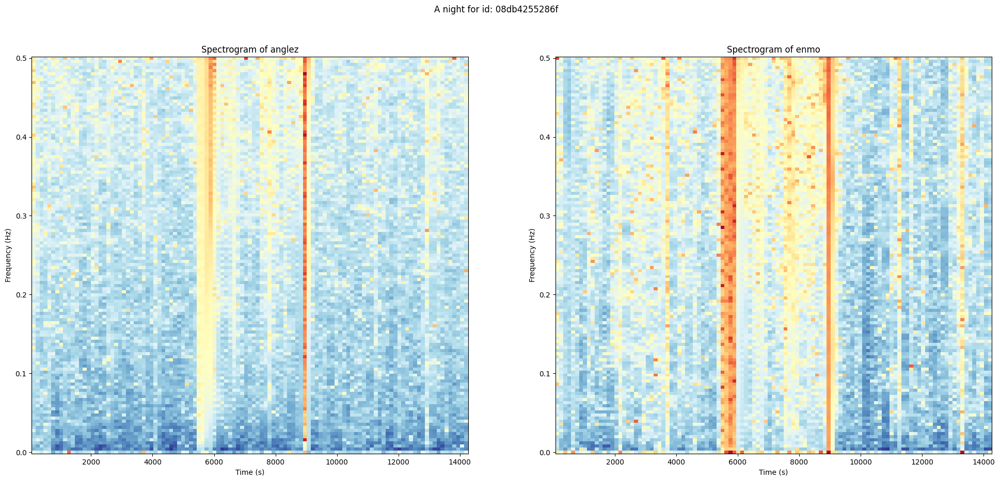

###  Spectrogram: 08db4255286f, night 21

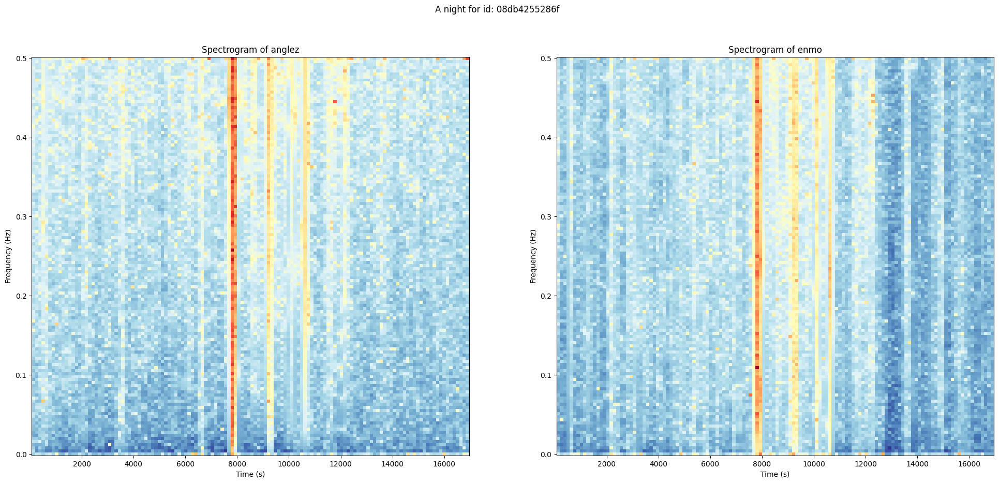

###  Spectrogram: 08db4255286f, night 22

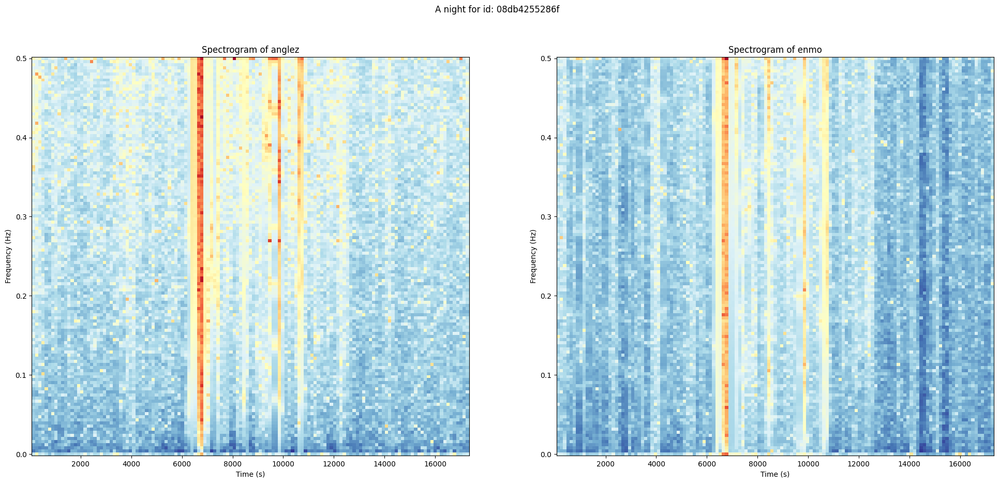

###  Spectrogram: 08db4255286f, night 23

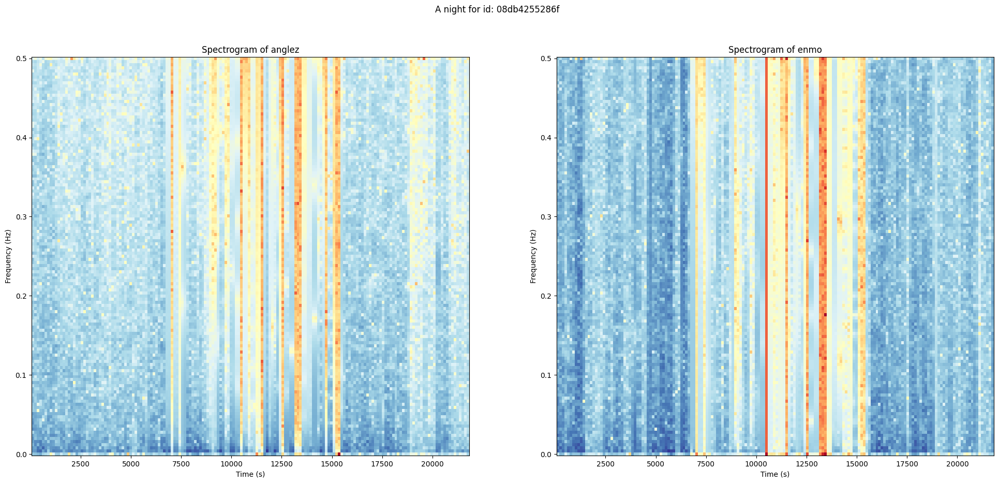

###  Spectrogram: 08db4255286f, night 24

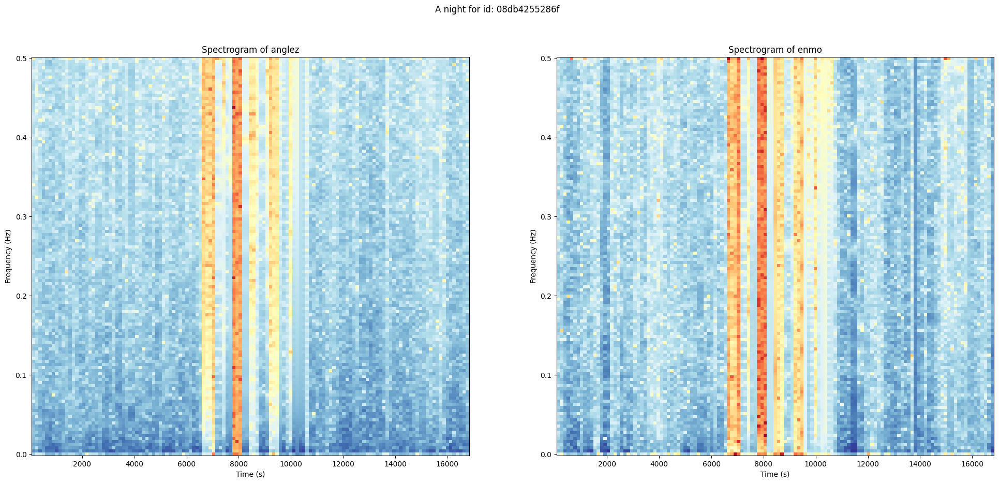

###  Spectrogram: 08db4255286f, night 25

/tmp/ipykernel_20/3681822009.py:46: RuntimeWarning:

divide by zero encountered in log10



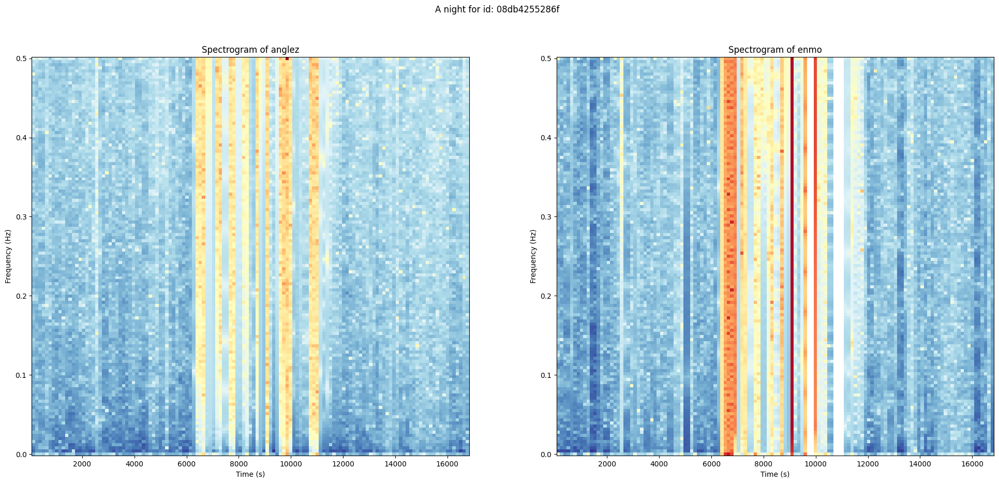

In [95]:
series_id = '08db4255286f'
build_spectrogram(series_id)

In [96]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 169446 objects.


## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Spectrogram: Series '0a96f4993bd7'</div>

/tmp/ipykernel_20/3261353427.py:42: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



###  Spectrogram: 0a96f4993bd7, night 1

/tmp/ipykernel_20/3681822009.py:38: RuntimeWarning:

divide by zero encountered in log10

/tmp/ipykernel_20/3681822009.py:46: RuntimeWarning:

divide by zero encountered in log10



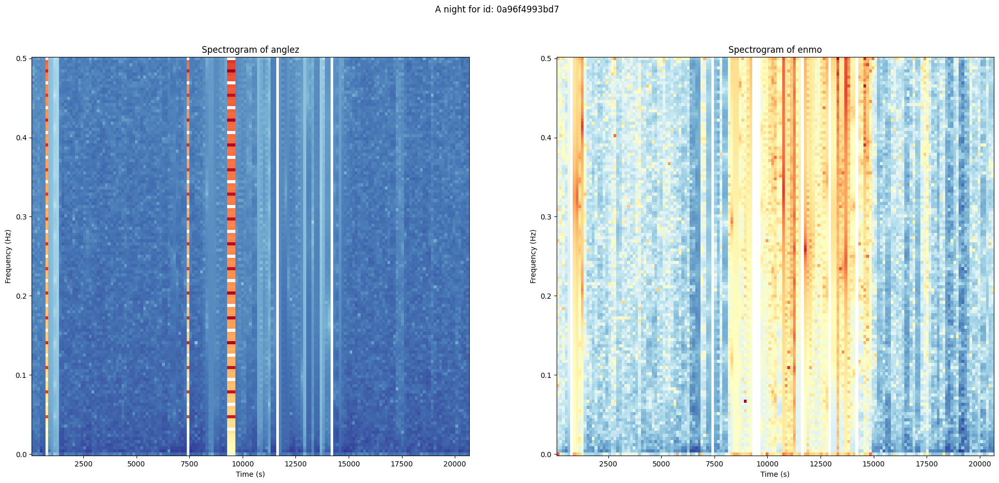

###  Spectrogram: 0a96f4993bd7, night 2

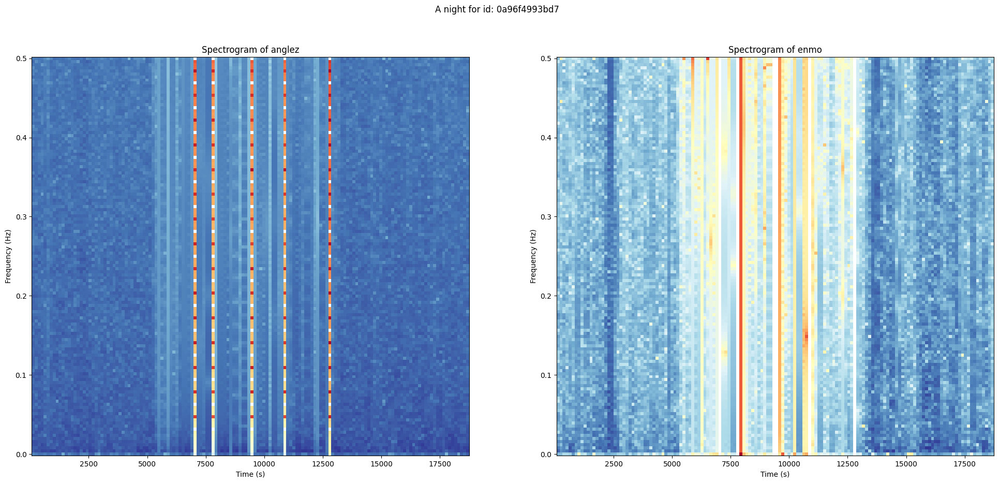

###  Spectrogram: 0a96f4993bd7, night 3

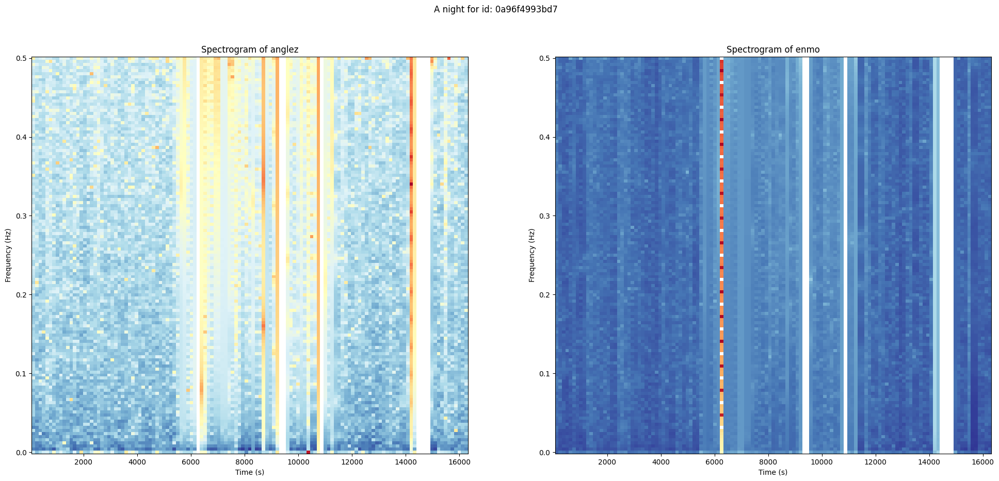

###  Spectrogram: 0a96f4993bd7, night 4

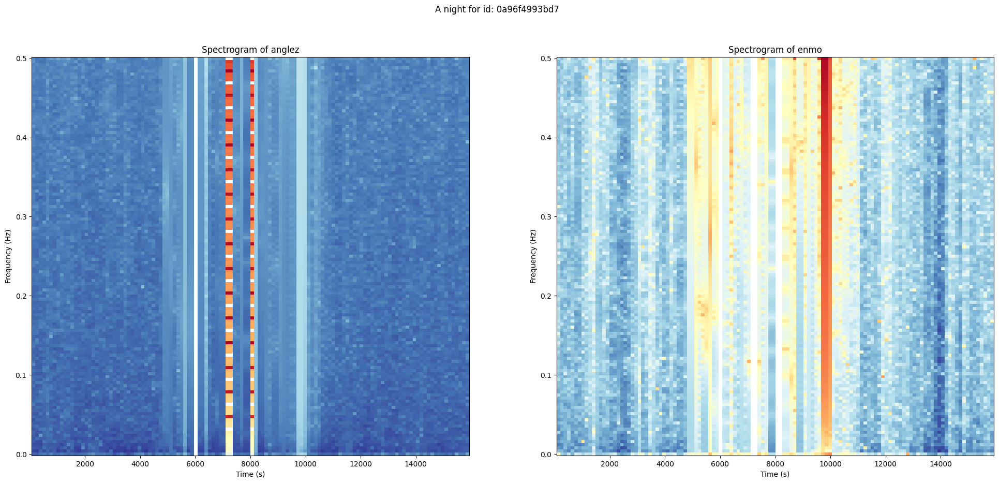

###  Spectrogram: 0a96f4993bd7, night 5

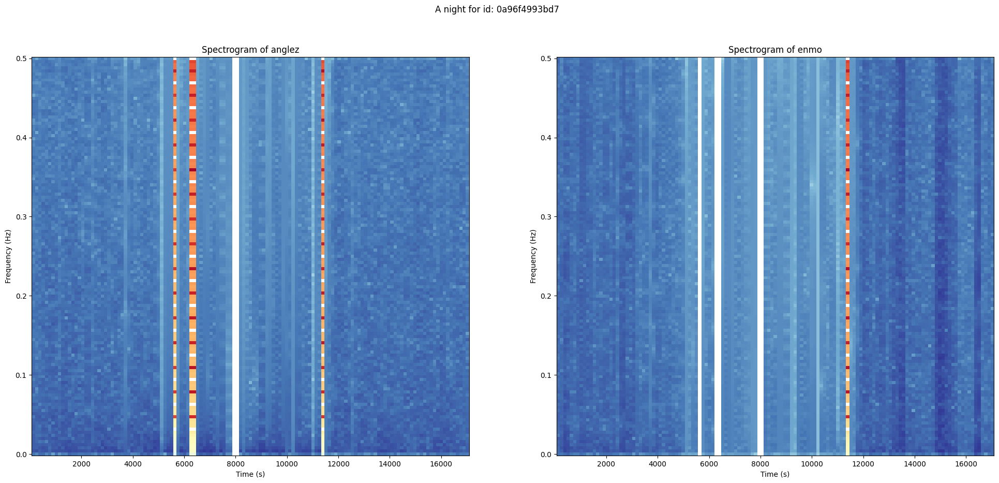

###  Spectrogram: 0a96f4993bd7, night 6

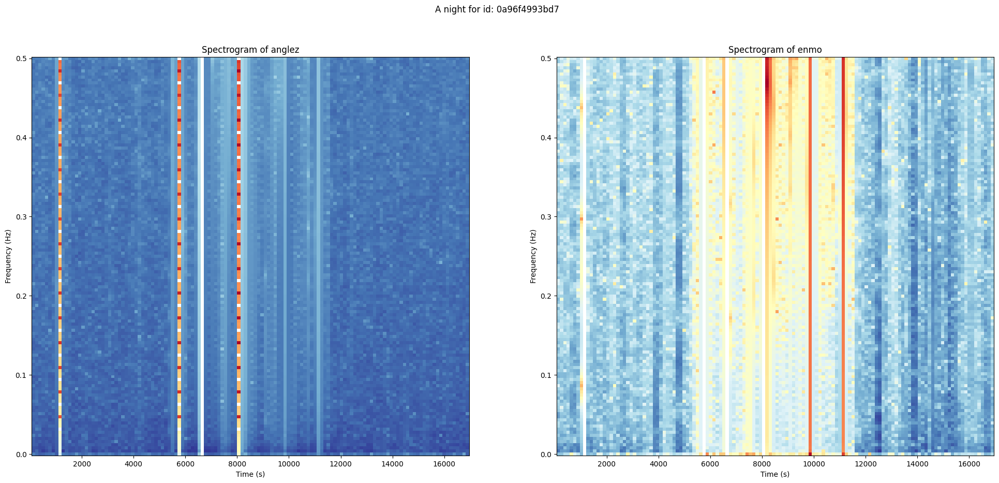

###  Spectrogram: 0a96f4993bd7, night 7

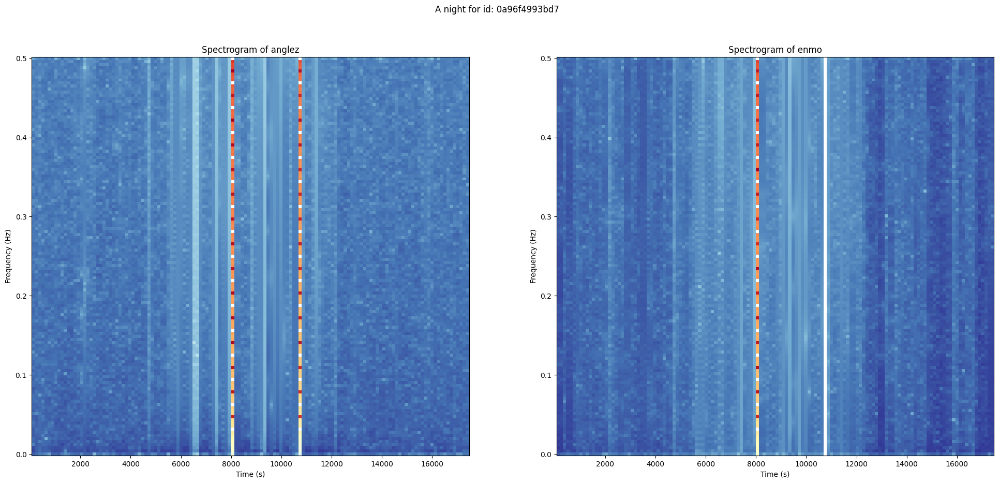

###  Spectrogram: 0a96f4993bd7, night 8

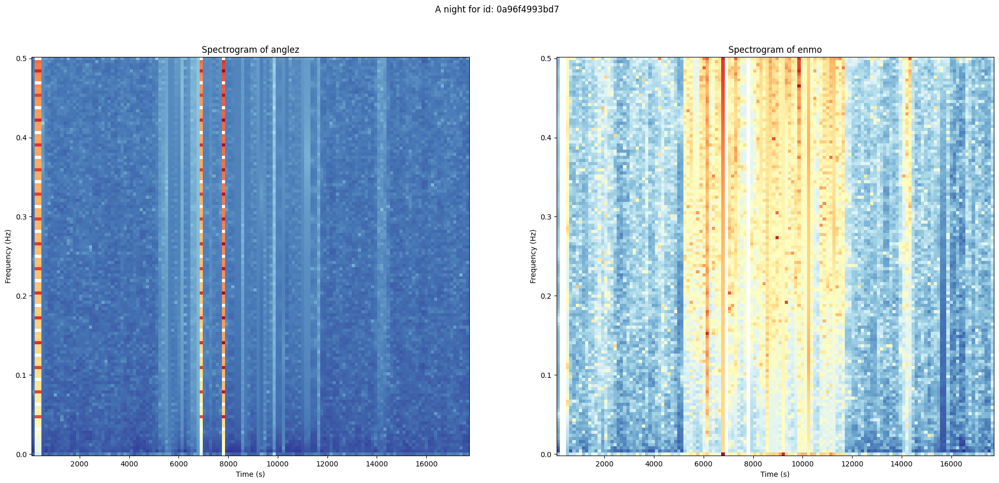

###  Spectrogram: 0a96f4993bd7, night 9

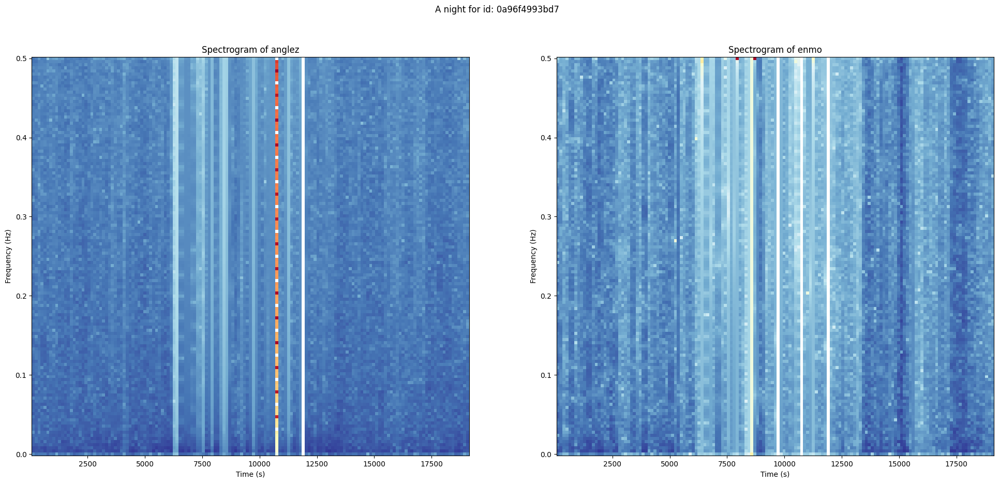

###  Spectrogram: 0a96f4993bd7, night 10

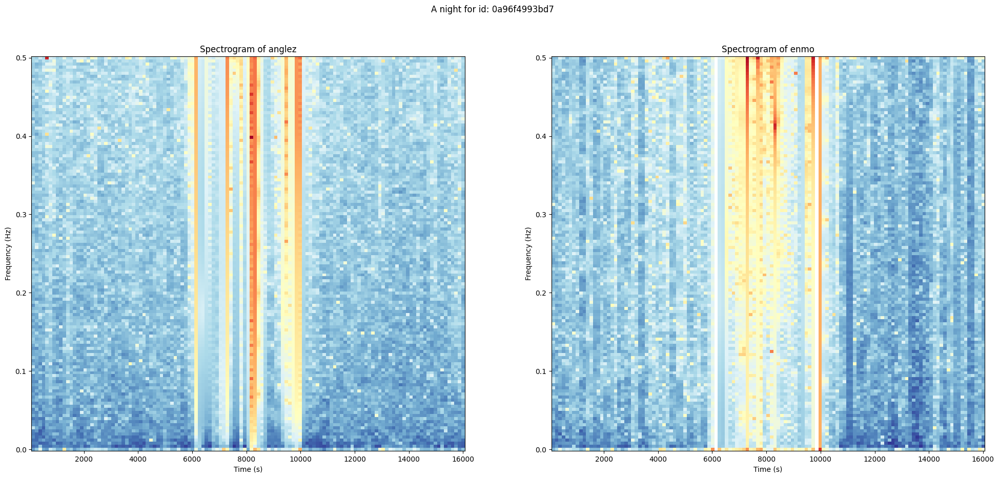

###  Spectrogram: 0a96f4993bd7, night 11

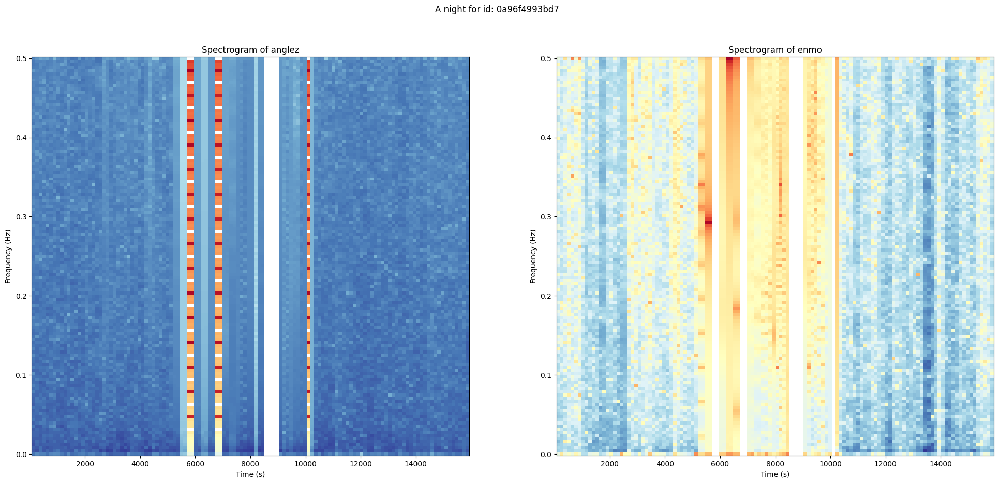

###  Spectrogram: 0a96f4993bd7, night 12

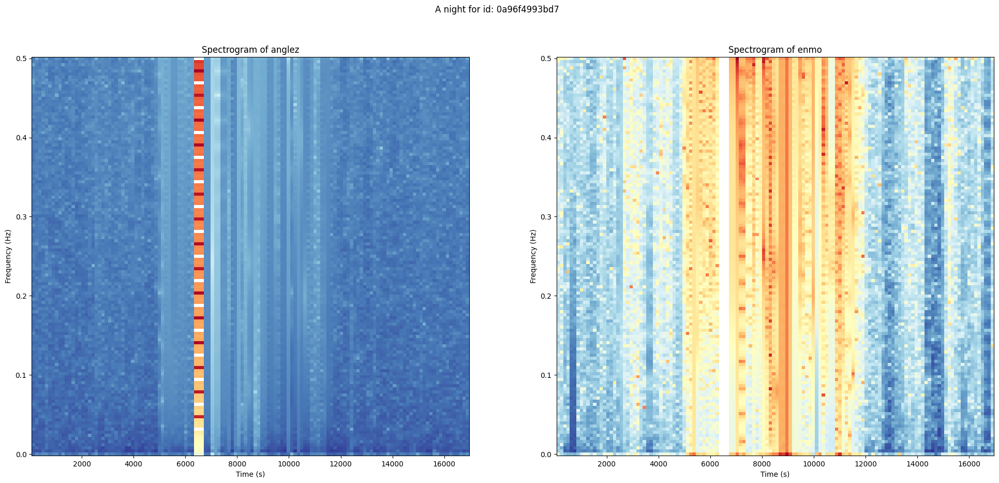

###  Spectrogram: 0a96f4993bd7, night 13

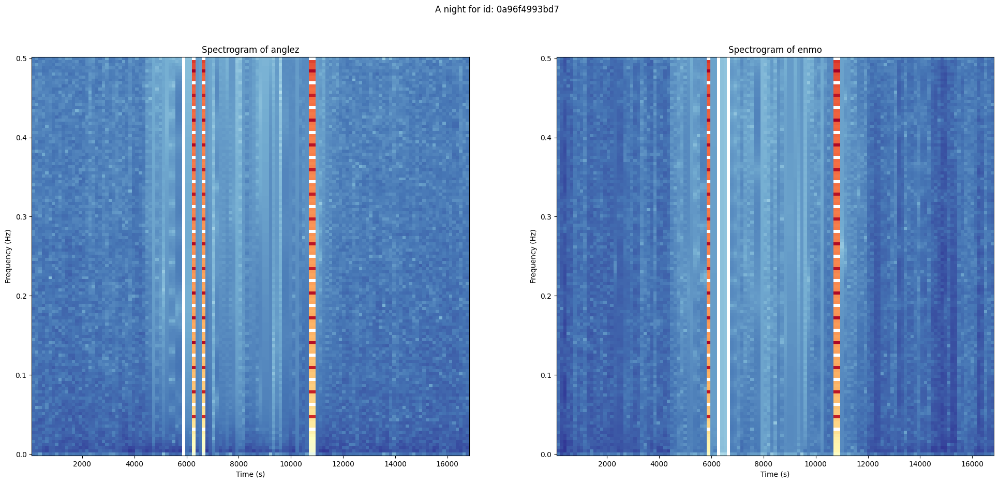

###  Spectrogram: 0a96f4993bd7, night 14

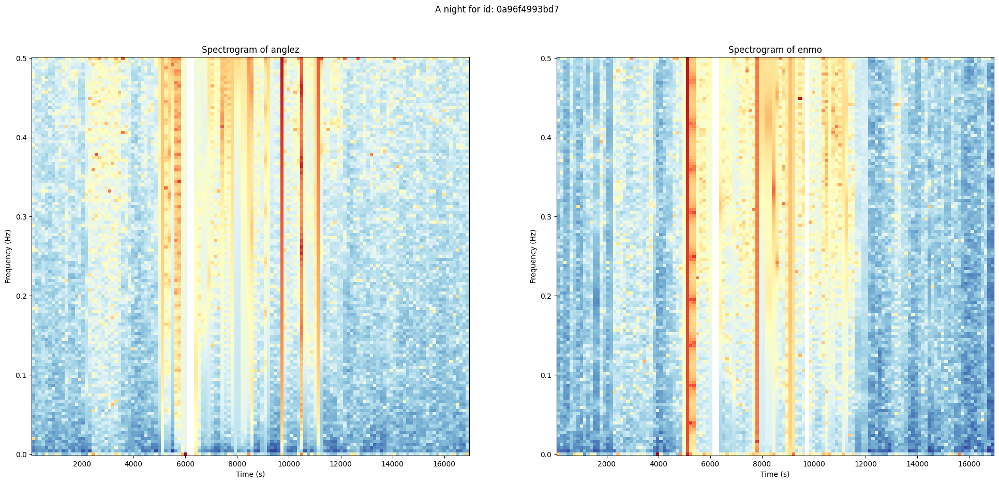

###  Spectrogram: 0a96f4993bd7, night 15

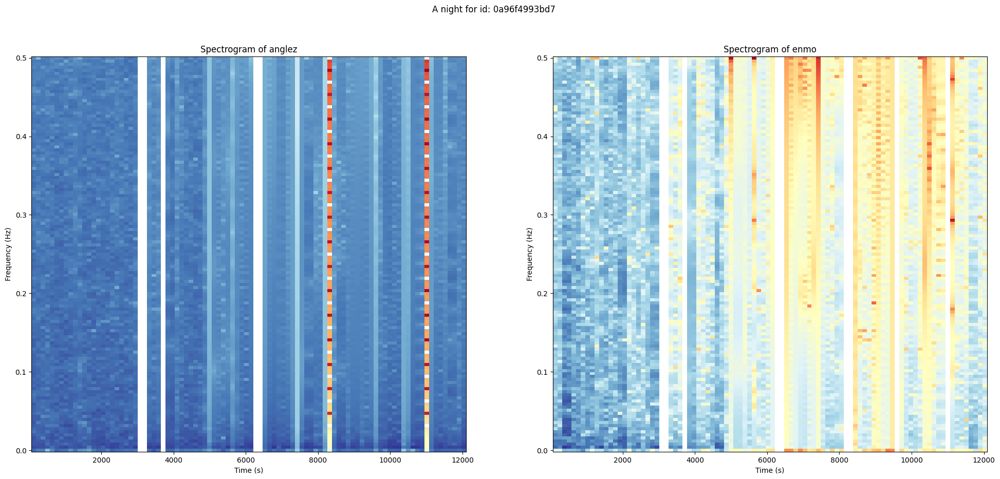

In [97]:
series_id = '0a96f4993bd7'
build_spectrogram(series_id)

In [98]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 60826 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Clustering Training Seria</div>

Let's look at the training series through the prism of the summary statistics for *anglez* and *enmo* across the individual series.

First of all, let's extract and review the summary statistics on *enmo* for every training series

In [99]:
df_series_enmo = get_all_series_boxplot_data('train_series', 'enmo')
df_series_enmo.head(10)

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

,series_id,min_value,q1,median,q3,max_value,mean_value,stddev
0,062cae666e2a,0.0,0.0109,0.0167,0.0289,1.0572,0.024059,0.023923
1,0ef7d94fde99,0.0,0.0022,0.0204,0.0383,3.0041,0.038333,0.078492
2,16fe2798ed0f,0.0,0.0073,0.0166,0.0315,3.1156,0.029059,0.053128
3,1716cd4163b2,0.0,0.0000,0.0040,0.0338,3.1775,0.030274,0.074344
4,1762ab70ec76,0.0,0.0000,0.0074,0.0467,3.0865,0.035565,0.077265
5,1955d568d987,0.0,0.0000,0.0047,0.0275,4.2296,0.024028,0.064470
6,1d4569cbac0f,0.0,0.0035,0.0262,0.0516,3.5300,0.040194,0.069246
7,1f96b9668bdf,0.0,0.0012,0.0133,0.0556,3.5614,0.040218,0.085435
8,2654a87be968,0.0,0.0082,0.0240,0.0422,1.9634,0.031170,0.038474
9,2e9ced2c7976,0.0,0.0000,0.0137,0.0519,6.0970,0.058787,0.186532


Now, let's extract and review the summary statistics on *anglez* for every training series

In [100]:
df_series_anglez = get_all_series_boxplot_data('train_series', 'anglez')
df_series_anglez.head(10)

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

,series_id,min_value,q1,median,q3,max_value,mean_value,stddev
0,062cae666e2a,-89.494102,-38.805000,-23.566900,-9.558300,87.619499,-24.191442,23.246397
1,16fe2798ed0f,-89.739998,-27.895201,-10.506700,5.180100,89.277298,-10.004472,31.256172
2,1716cd4163b2,-89.775299,-9.982000,15.902400,40.642799,89.528503,13.209660,37.504565
3,1762ab70ec76,-89.671997,-28.240499,-5.969700,16.462500,89.590698,-5.407753,36.998665
4,1955d568d987,-89.539803,-33.830399,-2.088800,29.609800,89.655899,-2.194052,42.720839
5,1d4569cbac0f,-89.682198,-28.391701,-17.700399,-6.079900,90.000000,-17.007494,25.761475
6,1f96b9668bdf,-90.000000,-31.509600,-19.338200,-7.242100,88.447601,-19.130826,26.772359
7,2654a87be968,-89.400803,-15.518700,-2.985800,7.652000,89.312500,-3.956308,23.130466
8,2e9ced2c7976,-90.000000,-32.323898,-7.927100,13.511800,89.286697,-6.961907,35.969693
9,3318a0e3ed6f,-90.000000,-37.309200,-16.001499,3.763700,89.552803,-15.490352,32.581220


TBD

In [101]:
# Returns the number of
# objects it has collected
# and deallocated
collected = gc.collect()
 
# Prints Garbage collector
# as 0 object
print("Garbage collector: collected",
          "%d objects." % collected)# Importing gc module

Garbage collector: collected 0 objects.


# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">References</div>

- https://www.datacamp.com/blog/an-introduction-to-duckdb-what-is-it-and-why-should-you-use-it
- https://duckdb.org/docs/sql/functions/timestamp
- https://duckdb.org/docs/sql/functions/dateformat
- https://duckdb.org/docs/sql/aggregates
- https://pub.towardsai.net/3-best-often-better-alternatives-to-histograms-b588f3850ce8
- https://towardsdatascience.com/probability-distribution-functions-demystified-a6e882759af3
- https://cs.stackexchange.com/questions/118065/build-a-histogram-from-a-very-large-data-sample
- https://chart-studio.plotly.com/~chris/18051/#code
- https://community.plotly.com/t/boxplot-with-precomputed-quartiles-without-displaying-data/71031

# <div style="color:white;background-color:#1d1545;padding:3%;border-radius:50px 50px;font-size:1em;text-align:center">Appendix: Methodology of EDA for large datasets</div>

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Concepts</div>

TBD

## <div style="font-size:20px;text-align:center;color:black;border-bottom:5px #0026d6 solid;padding-bottom:3%">Implementation Notes</div>

TBD